# Explore Topic modelling using LDA

In [75]:
from spacy_preprocessor import SpacyPreprocessor
import sqlalchemy as db
import pandas as pd
import tqdm

# Connect to DB and grab tables

In [76]:
engine = db.create_engine('postgresql://localhost:5432/lyricsdb')
connection = engine.connect()
metadata = db.MetaData()
artists = db.Table('artists', metadata, autoload=True, autoload_with=engine)
songs = db.Table('songs', metadata, autoload=True, autoload_with=engine)

In [77]:
query = 'SELECT * FROM songs;'
song_df_db = pd.read_sql(query, connection)

In [78]:
query = 'SELECT * FROM artists;'
artist_df_db = pd.read_sql(query, connection)

# Grab some songs

In [79]:
normal_songs = song_df_db[(song_df_db["lyrics"].str.len() <= 3500) & (song_df_db["lyrics"].str.len() >= 400)]

In [80]:
normal_songs

,artist_id,song_title,lyrics
2,347,Okie from Muskogee,We don't smoke marijuana in Muskogee\nWe don't...
3,347,Mama Tried,The first thing I remember knowing\nWas a lone...
4,347,One Day at a Time,"I'm only human, I'm just a man\nHelp me to bel..."
5,347,Sing Me Back Home,The warden led a prisoner down the hallway to ...
6,347,That’s the Way Love Goes,I've been throwing horseshoes over my left sho...
...,...,...,...
52165,1455,Pay The Price (Deluxe Album Version) (Previous...,"(D. Snider)\nYou and I, we lit the fire\nWe bu..."
52166,1455,Bad Boys (Of Rock ‘N’ Roll) (Another Version),All right\nSo we look kind of weird to you\nWe...
52167,1455,The Price [Early Demo] (Deluxe Album Version) ...,How long I have wanted\nThis dream to come tru...
52168,1455,Stay Hungry [Early Demo] (Deluxe Album Version...,Are you feeling the fire?\nAre you ready to ex...


In [81]:
sub_df = normal_songs.sample(n=10000, random_state=1)

In [82]:
def remove_duplicate_songs(song_dataframe):
    song_titles_dict = {}
    index_removal_list = []
    for i, row in song_dataframe.iterrows():
        artist_id = row["artist_id"]
        if artist_id in song_titles_dict.keys():  
            for song in song_titles_dict[artist_id]:
                if row["song_title"] in song or song in row["song_title"]:
                    # print(row["song_title"])
                    index_removal_list.append(i)
            else:
                song_titles_dict[artist_id].append(row["song_title"])
        else: 
            song_titles_dict[artist_id] = [row["song_title"]]
            
        return(song_dataframe)

In [83]:
sub_df = remove_duplicate_songs(sub_df)

# Create Spacy Model

In [84]:
spacy_model = SpacyPreprocessor.load_model()

In [85]:
extra_stop_words = ["ooh", "oh", "ah", "la", "ha", "yeah", "to", "get", "let" , 
                    "gonna", "too", "gon", "na", "gotta", "got", "ta"]

In [86]:
preprocessor = SpacyPreprocessor(spacy_model=spacy_model, lemmatize=True, remove_numbers=True, remove_stopwords=True, extra_stop_words=extra_stop_words)

adding stop words
adding ooh
adding oh
adding ah
adding la
adding ha
adding yeah
adding to
adding get
adding let
adding gonna
adding too
adding gon
adding na
adding gotta
adding got
adding ta


In [87]:
clean_lyrics_list = preprocessor.preprocess_text_list(list(sub_df.lyrics))

74it [00:10,  7.40s/it]

remove stop words
[Oh, baby, baby, baby, 
, Blues, and, sorrow, 
, And, I, love, you, tomorrow, 
, Just, suit, you, just, fine, 
, Oh, baby, baby, baby, 
, Blues, and, sorrow, 
, And, I, love, you, tomorrow, 
, Just, suit, you, just, fine, 

, I, ca, n't, forget, that, you, told, me, 
, So, many, promising, lies, 
, How, must, I, forget, these, 
, Lonesome, tears, in, my, eyes, ?, 

, You, 've, broken, my, heart, 
, Gon, na, do, it, again, 
, And, I, ca, n't, forget, 
, The, spell, that, I, 'm, in, 
, Ca, n't, forget, that, you, told, me, 
, So, many, promising, lies, 
, I, 'm, a, -, trying, to, forget, these, 
, Lonesome, tears, in, my, eyes]
[baby, baby, baby, 
, Blues, sorrow, 
, love, tomorrow, 
, suit, fine, 
, baby, baby, baby, 
, Blues, sorrow, 
, love, tomorrow, 
, suit, fine, 

, forget, told, 
, promising, lies, 
, forget, 
, Lonesome, tears, eyes, ?, 

, broken, heart, 
, 
, forget, 
, spell, 
, forget, told, 
, promising, lies, 
, -, trying, forget, 
, Lonesome, tears, eyes

183it [00:10,  3.63s/it]


[You, say, that, you, 're, gon, na, go, 
, I, suppose, you, know, what, 's, best, for, you, 
, So, go, ,, run, with, the, wind, 
, Taste, the, sun, ,, feel, the, spin, of, worlds, 
, Unknown, to, me, ,, but, come, home, to, me, 
, At, your, journey, 's, end, I, 'll, be, here, 
, I, 'll, be, near, anytime, you, need, me, 
, Need, me, ,, I, 'll, be, here, 
, So, go, ,, play, in, jeweled, cities, 
, Play, with, pretties, 
, Tie, ribbons, in, your, hair, 
, And, if, you, find, the, lookin, ', glass, 
, Please, stay, and, ask, 
, The, other, side, 
, Who, 's, that, standing, there, ?, 
, Who, 's, that, standing, there, ?, 
, What, 's, her, name, ?, 
, Does, she, still, wear, mornin, ', in, her, hair, ?, 
, Smile, the, same, ,, the, same, ?, 
, (, Ah, ,, ah, ,, ah, ,, ah, ,, ah, ), 
, Who, 's, that, standing, there, ?, 
, Who, 's, that, standing, there, ?, 
, What, 's, her, name, ?, 
, Does, she, still, wear, mornin, ', in, her, hair, ?, 
, Smile, the, same, ,, the, same, ?, 
, (, Ah, ,, ah

308it [00:11,  1.78s/it]


[Green, hocker, croakin, ', 
, In, the, Pygmy, Twylyte, 
, Crankin, ’, an, ', a, -, coke'n, 
, In, the, Winchell, ’s, do, -, nut, Midnite, 
, Out, of, his, deep, on, a, ', fore, day, run, 
, Hurtin, ', for, sleep, in, the, Quaalude, Moonlight, 
, Green, hocker, in, a, Greyhound, locker, 
, Smokin, ', in, the, Pygmy, Twylyte, 
, Joined, the, bus, on, the, 33rd, seat, 
, By, the, doo, -, doo, room, with, the, reek, replete, 
, Crystal, eye, ,, crystal, eye, 
, Got, a, crystal, kidney, &, he, 's, fraid, to, die, 
, In, the, Pygmy, Twylyte, 
, Downer, midnite, 
, Pygmy, Twylyte, 
, Downer, midnite, 
, Pygmy, Twylyte, 
, Downer, midnite, 
, Pygmy, Twylyte, 
, Downer, midnite]
[Green, hocker, croakin, ', 
, Pygmy, Twylyte, 
, Crankin, ’, ', -, coke'n, 
, Winchell, -, nut, Midnite, 
, deep, ', fore, day, run, 
, Hurtin, ', sleep, Quaalude, Moonlight, 
, Green, hocker, Greyhound, locker, 
, Smokin, ', Pygmy, Twylyte, 
, Joined, bus, 33rd, seat, 
, doo, -, doo, room, reek, replete, 
, Crystal,

427it [00:11,  1.15it/s]


[life, ,, face, huge, assortment, 
, nauseating, fads, good, advice, 
, health, ,, fitness, ,, diet, ,, deportment, 
, pointless, forms, sacrifice, 
, Conversation, ?, Wit, ?, doubter, 
, Manners, ?, Charm, ?, way, impress, 
, forget, inner, ,, observe, outer, 
, wear, dress, 
, ,, believe, lookin, ', 
, Like, time, earth, cookin, ', 
, polka, dotted, ,, striped, checked, 
, glamour, guaranteeing, 
, fiber, 
, displayed, remarkable, effect, 
, cradle, trousseau, 
, deathbed, view, ,, 
, compromise, ,, accept, substitute, 
, wear, barrel, 
, conservative, apparel, 
, dress, ..., strongest, suit, 
, (, Overwear, ,, underwear, ,, anytime, ,, ), 
, Staying, hitting, town, -, wards, 
, working, downwards, 
, ensure, stitch, stitched, time, (, stitched, time, ), 
, wig, hat, turban, 
, clad, boudoir, urban, 
, strut, stuff, outrageously, crime, (, crime, ), 
, invited, (, Overwear, ), 
, wardrobe, delighted, (, Underwear, ), 
, wander, things, (, Anytime, ), 
, find, en, route, (, wandering

551it [00:11,  2.34it/s]


lemmatize
[real, cowboys, Left, hills, fire, hit, iron, time, dusty, pick, Come, rolling, road, load, feed, sun, gets, high, hope, working, cowboy, dies, snortin, cocaine, honky, tonk, closed, prays, rain, heaven, knows, good, feed, brings, money, money, buys, clothes, diamond, sequins, shining, TV, kind, working, cowboy, needs, country, families, working, hand, hand, Trying, hard, stay, stand, rows, rows, houses, Come, creepin, land, cattle, graze, old, gray, barn, stands, real, cowboys, land, real, cowboys, land]
real cowboy leave hill fire hit iron time dusty pick come roll road load feed sun get high hope work cowboy die snortin cocaine honky tonk closed pray rain heaven know good feed bring money money buy clothe diamond sequin shine tv kind work cowboy need country family work hand hand try hard stay stand row row house come creepin land cattle graze old gray barn stand real cowboy land real cowboy land
remove stop words
[Welcome, to, a, trip, into, my, hurt, feelings, 
, To, th

741it [00:11,  6.76it/s]


[The, Muffin, Man, is, seated, at, the, table, 
, In, the, laboratory, of, the, Utility, Muffin, Research, Kitchen, ., ., 
, Reaching, for, an, oversized, chrome, spoon, 
, He, gathers, an, intimate, quantity, of, dried, muffin, remnants, 
, And, ,, brushing, his, scapular, aside, 
, Proceeds, to, dump, these, inside, of, his, shirt, ., ., 
, He, turns, to, us, and, speaks, :, 
, ", Some, people, like, cupcakes, better, ., I, ,, for, 
, Care, LESS, for, them, !, ", 
, Arrogantly, twisting, the, sterile, canvas, snoot, of, a, fully, charged, icing, -, anointment, utensil, 
, He, poots, forth, a, quarter, -, ounce, green, rosetta, 
, Near, ., ., 
, (, Let, 's, try, that, again, ., ., ., ), 
, He, poots, forth, a, quarter, -, ounce, green, rosetta, 
, Near, the, summit, of, a, dense, -, but, -, radiant, muffin, of, his, own, design, 
, Later, he, says, :, 
, ", Some, people, ., ., ., some, people, like, cupcakes, exclusively, 
, While, I, myself, say, there, is, naught, ,, nor, ought, th

871it [00:12, 13.65it/s]

remove stop words
[You, bring, up, 
, Well, ,, who, 'd, you, want, me, to, -, Yes, ?, 
, We, have, mean, -, nothing, !, 
, And, there, you, have, it, ,, Bernie, 
, of, them, in, front, of, them, blues, ,, they, 're, getting, you, 
, Yeah, and, in, part, of, a, down, 
, And, can, I, buy, you, -, Dang, it, -,  , -, Goddamn, !, 
, Fetch, me, a, drink, !, 
, What, ?, 
, Have, a, drink, 
, Can, I, drop, it, ?, 
, Fetch, me, a, drink, 
, Having, a, day, downed, in, rhythm, 
, Honey, ,, we, was, just, hopin, ', if, we, get, it, all, right, 
, I, 've, been, -, I, 've, been, drinking, for, years, -, years, 
, How, many, was, it, ,, Toulouse, ?, 
, Yeah, ,, I, 've, been, drinking, for, years, ,, I, 'm, born, !, I, 'm, dead, !, 
, I, 'm, not, going, down, !, !, !]
[bring, 
, ,, want, -, Yes, ?, 
, mean, -, !, 
, ,, Bernie, 
, blues, ,, getting, 
, 
, buy, -, Dang, -,  , -, Goddamn, !, 
, Fetch, drink, !, 
, ?, 
, drink, 
, drop, ?, 
, Fetch, drink, 
, Having, day, downed, rhythm, 
, Honey, ,, hop

934it [00:12, 19.32it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

1099it [00:22, 24.34it/s]

remove stop words
[Love, is, a, burning, thing, 
, And, it, makes, a, fiery, ring, 
, Bound, by, wild, desire, 
, I, fell, in, to, a, ring, of, fire, 

, I, fell, into, a, burning, ring, of, fire, 
, I, went, down, ,, down, ,, down, 
, And, the, flames, went, higher, 
, And, it, burns, ,, burns, ,, burns, 
, The, ring, of, fire, 
, The, ring, of, fire, 
, I, fell, into, a, burning, ring, of, fire, 
, I, went, down, ,, down, ,, down, 
, And, the, flames, went, higher, 
, And, it, burns, ,, burns, ,, burns, 
, The, ring, of, fire, 
, The, ring, of, fire, 

, The, taste, of, love, is, sweet, 
, When, hearts, like, ours, meet, 
, I, fell, for, you, like, a, child, 
, Oh, ,, but, the, fire, went, wild, 

, I, fell, in, to, a, burning, ring, of, fire, 
, I, went, down, ,, down, ,, down, 
, And, the, flames, went, higher, 
, And, it, burns, ,, burns, ,, burns, 
, The, ring, of, fire, 
, The, ring, of, fire, 
, I, fell, into, a, burning, ring, of, fire, 
, I, went, down, ,, down, ,, down, 
, A

1184it [00:22, 46.88it/s]

remove stop words
[You, can, fool, yourself, 
, You, can, cheat, until, you, 're, blind, 
, You, can, cut, your, heart, 
, It, can, happen, 
, You, can, mend, the, wires, 
, You, can, feed, the, soul, apart, 
, You, reach, 
, It, can, happen, to, you, 
, It, can, happen, to, me, 
, It, can, happen, to, everyone, eventually, 
, (, It, 's, a, constant, fight, ), 
, A, constant, fight, 
, You, 're, pushing, the, needle, to, the, red, 
, (, Black, and, white, ), 
, Who, knows, who, 's, right, 
, No, substitute, you, 're, born, you, 're, dead, 
, (, Fly, by, night, ), 
, Created, out, of, fantasy, 
, Our, destination, calls, 
, Look, up, -, look, down, 
, Look, out, -, look, around, 
, Look, up, -, look, down, 
, There, 's, a, crazy, world, outside, 
, We, 're, not, about, to, lose, our, pride, 
, It, can, happen, to, you, 
, It, can, happen, to, me, 
, It, can, happen, to, everyone, eventually, 
, As, you, happen, to, say, 
, It, can, happen, today, 
, As, it, happens, it, happens, in, eve

1261it [00:22, 83.13it/s]


[Some, people, call, me, a, teenage, idol, 
, Some, people, say, they, envy, me, 
, I, guess, they, got, no, way, of, knowing, 
, How, lonesome, I, can, be, 
, I, need, somebody, to, be, my, baby, 
, Someone, to, tell, my, troubles, to, 
, I, got, no, time, to, ever, find, her, 
, 'Cause, I, 'm, just, passing, through, 
, I, travel, around, from, town, to, lonely, town, 
, I, guess, I, 'll, always, be, just, a, rolling, stone, 
, If, I, find, fortune, and, fame, 
, And, lots, of, people, know, my, name, 
, That, wo, n't, mean, a, thing, if, I, 'm, all, alone, 
, I, got, no, rest, when, I, 'm, feeling, weary, 
, I, got, to, pack, my, bags, and, go, 
, I, got, to, be, somewhere, tomorrow, 
, To, smile, and, do, my, show, 
, I, travel, around, from, town, to, lonely, town, 
, I, guess, I, 'll, always, be, just, a, rolling, stone, 
, If, I, find, fortune, and, fame, 
, And, lots, of, people, know, my, name, 
, That, wo, n't, mean, a, thing, if, I, 'm, all, alone, 
, Some, people, call, me

1378it [00:23, 147.80it/s]

remove stop words
[River, of, life, 
, Which, way, do, you, flow, 
, I, seem, to, be, lost, 
, Which, way, should, I, go, 
, I, trusted, you, once, 
, Ah, ,, you, did, n't, come, through, 
, I, really, resent, 
, What, else, could, I, do, 
, River, you, are, flowing, upstream, 
, Now, with, you, ,, you, 're, taking, my, dream, 
, River, river, where, will, you, fall, 
, Cause, I, 've, been, waiting, in, awe, 
, Where, will, you, fall, 
, River, of, death, 
, Ah, who, will, you, take, 
, I, 'd, like, to, know, 
, For, my, own, sake, 
, I, 've, got, some, things, 
, Ah, that, I, 'd, like, to, do, 
, Whether, or, not, 
, Well, ,, it, 's, all, up, to, you, 
, River, you, are, flowing, upstream, 
, Now, with, you, ,, you, 're, taking, my, dream, 
, River, river, where, will, you, fall, 
, Cause, I, 've, been, waiting, in, awe, 
, Where, will, you, fall, 
, Oh, that, river, of, life, keeps, flowing, 
, And, no, knows, where, it, 's, gone, ,, where, it, 's, going, 
, Oh, that, river, of, life

1507it [00:23, 243.69it/s]


lemmatize
[Asked, girl, wanted, said, baby, wanna, famous, star, screen, Baby, drive, car, Yes, star, Baby, drive, car, maybe, love, told, girl, prospects, good, said, baby, understood, Working, peanuts, fine, better, time, Baby, drive, car, Yes, star, Baby, drive, car, maybe, love, Beep, beep'm, beep, beep, Baby, drive, car, Yes, star, Baby, drive, car, maybe, love, told, girl, start, right, away, said, listen, babe, car, breakin, heart, found, driver, start, Baby, drive, car, Yes, star, Baby, drive, car, maybe, love, Beep, beep'm, beep, beep, Beep, beep'm, beep, beep, Beep, beep'm, beep, beep]
ask girl want say baby wanna famous star screen baby drive car yes star baby drive car maybe love tell girl prospect good say baby understand work peanut fine well time baby drive car yes star baby drive car maybe love beep beep'm beep beep baby drive car yes star baby drive car maybe love tell girl start right away say listen babe car breakin heart find driver start baby drive car yes star ba

1564it [00:23, 256.82it/s]


[situation, 
, need, contemplation, 
, systematic, 
, addict, love, 

, holds, 
, told, 
, girl, 
, holds, 
, told, 
, world, 

, think, long, known, 
, wrong, ,, lock, key, 
, confusing, 
, young, illusion, ,, 

, holds, 
, told, 
, girl, 
, holds, 
, told, 
, world, 

, Georgy, Porgy, ,, pudding, pie, 
, Kissed, girls, cry, 
, Georgy, Porgy, ,, pudding, pie, 
, Kissed, girls, cry, 
, Georgy, Porgy, ,, pudding, pie, 
, Kissed, girls, cry, 
, Kissed, girls, cry, 
, Kissed, girls, cry, 

, situation, 
, need, contemplation, 
, systematic, 
, addict, love, 

, holds, 
, told, 
, girl, 
, holds, 
, told, 
, world, 

, Georgy, Porgy, ,, pudding, pie, 
, Kissed, girls, cry, 
, Georgy, Porgy, ,, pudding, pie, 
, Kissed, girls, cry, 
, Georgy, Porgy, ,, pudding, pie, 
, Kissed, girls, cry, 
, Georgy, Porgy, ,, pudding, pie, 
, Kissed, girls, cry, 
, Georgy, Porgy, ,, pudding, pie, 
, Kissed, girls, cry, 
, Kissed, girls, cry, 
, Kissed, girls, cry, 
, Georgy, Porgy, ,, pudding, pie, 
, Kisse

1681it [00:23, 347.44it/s]


remove stop words
[When, I, was, a, boy, I, had, a, lot, of, fun, 
, I, lived, by, the, sea, ,, I, was, a, fisherman, 's, son, 
, My, mother, she, was, a, fisherman, 's, wife, 
, She, was, scrubbing, floors, most, of, her, life, 
, They, said, screw, you, 
, I, ai, n't, got, nothing, to, lose, 
, I, could, paper, a, matchbox, 
, With, the, money, I, use, 
, At, the, school, I, attended, I, got, into, fights, 
, I, was, beaten, in, an, alley, on, a, cold, winter, night, 
, The, teachers, cared, less, for, the, blood, in, our, veins, 
, They, got, most, of, their, thrills, out, of, using, a, cane, 
, They, said, screw, you, 
, Oh, you, bloody, young, fools, 
, I, could, get, more, sense, 
, Out, of, the, back, end, of, a, mule, 
, So, you, see, there, 's, man, who, get, paid, for, being, slaves, 
, And, men, who, get, paid, for, being, free, 
, And, there, 's, men, behind, bars, who, pray, for, the, light, 
, And, men, in, the, suburbs, who, pray, for, the, night, 
, And, they, 're, all

1785it [00:23, 405.49it/s]


[Riding, in, the, saddle, ,, henchmen, at, your, side, 
, Holy, macaroni, ,, hose, you, on, your, back, 
, And, the, bystanders, just, stand, there, like, oysters, on, a, shelf, 
, In, the, world, of, work, your, rivals, ,, that, you, have, yet, to, meet, 
, And, quite, a, bunch, they, are, in, the, morning, sun, 
, With, blinking, eyes, the, worthless, stands, 
, In, readiness, for, transport, to, the, battleground, 
, There, 's, dirty, work, ahead, of, them, and, quite, a, bunch, they, are, 
, What, do, you, do, with, a, life, of, work, ?, 
, What, do, you, do, with, a, life, of, work, ?, 
, What, do, you, do, with, a, life, of, work, ?, 
, Face, it, in, the, morning, ,, face, it, in, the, morning, 
, And, the, parting, of, the, ways, and, the, interrupted, mirth, 
, And, the, shock, that, has, to, come, because, of, what, you, want, 
, Compared, to, what, you, 've, got, 
, Meet, it, squarely, and, it, only, hurts, when, it, hurts, 
, Life, of, work, ,, early, in, the, morning]
[Rid

1897it [00:24, 468.39it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

2082it [00:34, 26.91it/s] 

remove stop words
[Kansas, City, ,, Kansas, City, here, I, come, ., Kansas, City, ,, Kansas, City, here, I, come, 
, Got, some, pretty, little, women, there, ,, I, 'm, gon, na, get, me, 
, Standing, on, the, corner, ,, crawl, straight, in, my, hand, 
, With, my, Kansas, City, Baby, ,, now, by, the, Kansas, City, world, 
, Well, the, water, in, the, city, ,, well, ,, taste, like, Georgia, Pie, 
, Going, to, Kansas, City, where, it, tastes, like, sugar, ,, oh, I, know, it, 
, Kansas, City, ,, Kansas, City, here, I, come, 
, Got, some, pretty, little, women, there, ,, I, 'm, gon, na, get, me, 
, Kansas, City, ,, here, every, night, you, gave, me, none, 
, Kansas, City, ,, surely, looked, like, they, were, done, 
, You, know, they, turned, it, around, now, Baby, ,, gon, na, scratch, it, ,, gon, na, run, 
, And, rock, with, my, Baby, ,, rock, with, my, Baby, ,, more, time, 
, Rock, with, my, Baby, ,, Kansas, City, Baby, ,, more, time, 
, Went, to, the, city, for, ,, for, this, souvenir, in,

2194it [00:34, 52.26it/s]


[Shattered, dreams, lay, broken, glass, 
, known, tonight, 
, left, memory, 
, wo, coming, home, tonight, 
, wasted, driver, twisted, path, 
, life, taken, flash, 
, ai, reason, ,, insanity, 
, answer, free, ?, 
, ,, 
, wake, 
, ,, ,, 
, saw, happening, like, deja, -, vu, 
, tried, tell, 
, victim, ,, waste, life, 
, wish, god, seen, light, 
, ,, 
, wake, 
, ,, ,, 
, Ohhhh, -, turned, lights, ?, 
, Ohhhh, -, shadow, night, 
, Ohhhh, -, meant, 
, wo, comin, ', home, ,, wo, comin, ', home, tonight, 
, ,, wo, comin, ', home, ,, wo, comin, ', home, tonight, 
, Shattered, dreams, lay, broken, glass, 
, known, tonight, 
, left, memory, 
, guess, things, meant, 
, ,, 
, wake, 
, ,, ,, 
, Ohhhh, -, turned, lights, ?, 
, Ohhhh, -, shadow, night, 
, Ohhhh, -, meant, 
, wo, comin, ', home, ,, wo, comin, ', home, tonight, 
, ,, wo, comin, ', home, ,, wo, comin, ', home, tonight]
lemmatize
[Shattered, dreams, lay, broken, glass, known, tonight, left, memory, wo, coming, home, tonight, wasted, driv

2307it [00:34, 95.80it/s]


lemmatize
[wound, tight, like, hairpin, trigger, ready, snap, driving, round, like, crash, test, dummy, map, thing, leads, maybe, day, sleep, wake, discover, live, life, like, wrecking, ball, carried, away, bounce, close, Live, life, like, wrecking, ball, table, old, game, Double, bet, hoping, luck, change, happened, live, life, like, wrecking, ball, Pretty, high, price, pay, slam, brick, wall, Live, life, like, wrecking, ball, Live, life, like, wrecking, ball, Pretty, high, price, pay, slam, brick, wall, Live, life, like, wrecking, ball, know, tough, man, standing, crawling, floor, coming, bumpy, landing, Better, circle, round, live, life, like, wrecking, ball, carried, away, bounce, close, Live, life, like, wrecking, ball]
wind tight like hairpin trigger ready snap drive round like crash test dummy map thing lead maybe day sleep wake discover live life like wrecking ball carry away bounce close live life like wrecking ball table old game double bet hope luck change happen live life 

2441it [00:34, 170.26it/s]

remove stop words
[I, could, have, been, a, brain, surgeon, 
, I, could, have, been, a, pharmacist, 
, I, gave, a, shot, at, radio, revivalist, 
, With, the, boss, man, I, 'd, have, never, been, missed, 

, Me, so, stupid, 
, What, is, my, IQ, ?, 
, What, is, my, intelligent, quotient, ?, 

, I, could, have, built, the, Golden, Gate, Bridge, 
, Or, Einstein, 's, nemesis, 
, I, could, have, been, a, derby, jockey, 
, But, it, 's, all, come, down, to, this, 


, I, could, have, built, Las, Vegas, 
, I, could, have, built, a, drum, sized, Rolls, Royce, 
, I, could, have, been, President, of, the, world, 
, Could, have, had, Ali, on, the, ropes, 

, Could, have, had, 
, Miss, August, ,, again, 
, Could, have, had, 
, Miss, May, ,, again, 
, Could, have, had, 
, Miss, September, ,, again, 
, But, I, waited, 
, Till, December, 

, Me, so, stupid, 
, What, is, my, IQ, ?, 
, What, is, my, intelligent, quotient, ?, 
, That, 's, so, wrong]
[brain, surgeon, 
, pharmacist, 
, gave, shot, radio, re

2563it [00:34, 264.96it/s]


[going, Chicago, ;, place, baby, strayed, 
, (, Hitch, hike, ), Hitch, hike, (, Hitch, hike, baby, ), 
, packing, bags, ,, going, leave, old, town, right, away, 
, (, Hitch, hike, ), Hitch, hike, (, Hitch, hike, baby, ), 
, find, girl, hitch, hike, world, 
, (, Hitch, hike, ), Hitch, hike, 
, Chicago, City, Limits, ,, sign, highway, read, 
, (, Hitch, hike, ), Hitch, hike, (, Hitch, hike, baby, ), 
, going, moving, till, street, corner, 6th, 3rd, 
, (, 6th, 3rd, ,, hitch, hike, baby, ), Hitch, hike, ,, 
, find, girl, hitch, hike, world, 
, (, Hitch, hike, ), Hitch, hike, ,, baby, 

, Hitch, hike, (, Hitch, hike, ), hitch, -, hike, (, Hitch, hike, baby, ), 
, right, (, Hitch, hike, ), Hitch, hike, Jenny, (, Hitch, hike, Susan, ), 
, Hitch, hike, (, Hitch, hike, ), Hitch, hike, (, Hitch, hike, dance, ), 
, ,, hitch, hike, (, Hitch, hike, ), Hitch, hike, Jenny, 
, (, Hitch, hike, baby, ,, hitch, hike, Susan, ), 
, (, Hitch, hike, baby, ,, hitch, hike, Susan, ), 
, (, Hitch, hike, baby, ,

2686it [00:35, 367.79it/s]


[Touch, me, 
, I, 'm, so, afraid, to, draw, you, close, 
, Hold, me, 
, Before, my, hands, fall, away, 
, I, 'll, suffocate, 
, If, I, ca, n't, breathe, you, in, 
, And, hold, you, there, 
, Forever, 
, I, left, a, message, at, the, hotel, 
, They, said, you, checked, out, 
, They, said, you, ai, n't, coming, back, 
, I, tried, to, call, you, 
, But, you, turned, off, your, cell, 
, And, it, said, at, the, tone, 
, Just, leave, me, alone, 
, And, I, fall, apart, at, the, seams, 
, It, seems, that, I, always, ,, always, fall, apart, 
, But, as, strong, as, I, am, 
, Why, ca, n't, I, break, your, heart, ?, 
, I, remember, how, it, used, to, be, 
, Making, love, to, you, all, night, long, 
, I, used, to, take, you, in, my, arms, 
, And, hold, you, there, until, all, my, strength, was, gone, 
, I, used, to, be, a, man, of, steel, 
, I, used, to, be, a, man, of, steel, 
, I, built, this, prison, that, I, thought, was, a, home, 
, And, we, both, lived, here, 
, Guess, you, were, living, alo

2813it [00:35, 418.92it/s]


drive cruisin old grapevine do road break think standin great country singer alive fix flat tire Merle ya sweet country pickin finger cover erl cause honky know Merle soul fix flat tire Merle hear adventurous youth makin love telephone booth hear little stretch jail big ranch house bar fancy car little check comin mail fix flat tire Merle ya sweet country pickin finger cover erl cause honky know Merle soul fix flat tire Merle hear record ya makin fun long haired kid ya know care ya think Merle world home ya know stone well joint drink think fix flat tire Merle ya sweet country pickin finger cover erl cause honky know Merle soul fix flat tire Merle fix flat tire Merle
remove stop words
[I, 'm, sorry, 
, Why, should, I, say, ,, I, 'm, sorry, ?, 
, If, I, hurt, you, 
, You, know, you, 've, hurt, me, too, 
, But, you, get, lost, inside, your, tears, 
, And, there, is, nothing, I, can, do, 
, 'Cause, I, get, lost, inside, my, fear, 
, That, I, am, nothing, without, you, 
, You, 're, angry,

2930it [00:35, 474.23it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

3085it [00:46, 24.92it/s] 

remove stop words
[Temptation, falls, in, your, path, 
, ", No, hesitation, ,, why, ?, ", you, ask, 
, You, have, another, waiting, at, home, 

, And, ,, yes, ,, she, matters, to, you, 
, Kind, of, woman, that, 'll, haunt, you, 
, She, matters, to, you, 
, Kind, of, woman, that, 'll, haunt, you, 
, She, matters, to, you, 

, You, did, n't, mean, to, meet, her, you, cry, 
, Oh, ,, but, the, sun, goes, down, every, night, 
, She, came, to, you, when, you, were, alone, 

, And, ,, yes, ,, she, matters, to, you, 
, Kind, of, woman, that, 'll, haunt, you, 
, Oh, ,, kind, of, woman, that, 'll, haunt, you, 
, She, matters, to, you, 

, I, promised, myself, a, long, time, ago, 
, No, ,, it, would, be, difficult, to, let, you, go, 
, If, not, at, least, within, 
, The, touch, of, my, fingers, 
, It, was, close, to, being, 
, In, heaven, 

, Kind, of, woman, that, 'll, haunt, you, 
, Heaven, 
, Kind, of, woman, that, 'll, haunt, you, 
, To, being, in, heaven, 
, Kind, of, woman, that, 'll, haunt

3164it [00:46, 47.70it/s]


lemmatize
[Buffalo, soldier, dreadlocked, rasta, Buffalo, Soldier, heart, America, Stolen, Africa, brought, America, Fighting, arrival, fighting, survival, mean, analyse, stench, makes, lot, sense, dreadlocked, rasta, Buffalo, Soldier, taken, Africa, brought, America, Fighting, arrival, fighting, survival, Said, Buffalo, Soldier, dreadlocked, Rasta, Buffalo, Soldier, heart, America, know, history, know, coming, ask, eck, think, Buffalo, Soldier, heart, America, Stolen, Africa, brought, America, Said, fighting, arrival, fighting, survival, Said, Buffalo, Soldier, win, war, America, Said, woy, yoy, yoy, woy, yoy, yoy, yoy, Woy, yoy, yoy, yoy, yoy, yoy, yoy, yoy, Woy, yoy, yoy, woy, yoy, yoy, yoy, Woy, yoy, yoy, yoy, yoy, yoy, yoy, yoy, Buffalo, Soldier, troddin, land, wo, ho, Said, want, ran, want, hand, Troddin, land, yea, hea, yea, ea, Said, Buffalo, Soldier, war, America, Buffalo, Soldier, dreadlocked, Rasta, Fighting, arrival, fighting, survival, Driven, mainland, heart, Caribbean, 

3258it [00:46, 88.01it/s]


[rolled, tumbled, ,, cried, night, long, 
, rolled, tumbled, ,, cried, night, long, 
, Woke, morning, ', ,, bet, money, wrong, 

, troubles, hard, ,, stand, strain, 
, troubles, hard, ,, stand, strain, 
, young, lazy, slut, charmed, away, brains, 

, landscape, glowing, ', ,, gleaming, ', golden, light, day, 
, landscape, glowing, ', ,, gleaming, ', gold, light, day, 
, holding, ', ,, standing, ', anybody, way, 

, ,, know, mind, 
, ,, know, mind, 
, ,, paid, paid, suffering, ', heart, line, 

, ,, dawn, lay, shade, 
, dawn, lay, shade, 
, ai, house, boy, ,, ai, trained, maid, 

, flat, -, spent, ,, woman, driving, ', tears, 
, flat, -, spent, ,, woman, driving, ', tears, 
, woman, crazy, ,, swear, ai, touch, years, 

, ,, warm, weather, coming, ', buds, vine, 
, warm, weather, comin, ', ,, buds, vine, 
, Ai, depressing, trying, satisfy, woman, 

, morning, ', ,, saw, rising, sun, return, 
, ,, morning, ', ,, seen, rising, sun, return, 
, Sooner, later, shall, burn, 

, night, filled,

3337it [00:46, 145.70it/s]


[Long, ,, long, lonely, nights, 
, cry, eyes, 
, Wond'ring, right, 
, left, broken, heart, 
, ,, long, ,, long, lonely, nights, 
, ,, miss, ,, dear, 
, ,, ,, come, 
, wish, 
, lonely, way, visualize, face, 
, pass, (, !, ), doorway, 
, left, face, ?, 
, ,, long, ,, long, lonely, nights, 
, guess, coming, home, 
, Long, ,, long, lonely, nights, 
, gone, 
, lonely, way, visualize, face, 
, pass, (, !, ), doorway, 
, left, face, ?, 
, ,, ,, ,, long, ,, long, lonely, nights, 
, guess, coming, home, 
, Long, ,, long, lonely, nights, 
, gone, 
, ,, ,, come, 
, gone, long]
lemmatize
[Long, long, lonely, nights, cry, eyes, Wond'ring, right, left, broken, heart, long, long, lonely, nights, miss, dear, come, wish, lonely, way, visualize, face, pass, doorway, left, face, long, long, lonely, nights, guess, coming, home, Long, long, lonely, nights, gone, lonely, way, visualize, face, pass, doorway, left, face, long, long, lonely, nights, guess, coming, home, Long, long, lonely, nights, gone, come,

3421it [00:46, 217.22it/s]


[arc, weather, stain, boards, 
, Ancient, goblins, warlords, 
, Come, ground, ,, making, sound, 
, smell, death, 
, night, cold, wind, blows, 
, cares, ,, knows, 

, wanna, buried, pet, sematary, 
, want, live, life, 
, wanna, buried, pet, sematary, 
, want, live, life, 

, Follow, Victor, sacred, place, 
, ai, dream, ,, escape, 
, Molars, fangs, ,, clicking, bones, 
, Spirits, moaning, tombstones, 
, night, ,, moon, bright, 
, cries, ,, ai, right, 

, wanna, buried, pet, sematary, 
, want, live, life, 
, wanna, buried, pet, sematary, 
, want, live, life, 

, moon, ,, air, 
, sudden, feel, chill, 
, Victor, grinning, ,, flesh, rotting, away, 
, Skeletons, dance, ,, curse, day, 
, night, wolves, cry, 
, Listen, close, hear, shout, 

, wanna, buried, pet, sematary, 
, want, live, life, 
, wanna, buried, pet, sematary, 
, want, live, life, 

, ,, 
, want, live, life, ,, ,, 
, want, live, life, ,, 
, want, live, life, ,]
lemmatize
[arc, weather, stain, boards, Ancient, goblins, warlords, 

3461it [00:46, 238.79it/s]

lemmatize
[pot, belly, big, Gets, way, driving, rig, Driving, country, big, old, rig, Things, seen, Mean, lot, Friend, pickup, Drives, kid, school, takes, wife, beauty, school, nails, Going, job, good, teacher, fork, road, ahead, know, way, going, turn, fork, road, ahead, year, salute, troops, fucking, war, good, idea, hope, eat, hope, giving, cashing, late, bailout, coming, creeps, watching, tickers, TV, bailout, coming, big, rock, star, sales, tanked, Thanks, Download, Sounds, like, shit, blogging, power, goes, battery, dead, Twist, shout, radio, days, Bring, bailout, coming, creeps, hiding, bailout, coming, Bailout, coming, flat, screen, repo, picked, Left, hole, wall, Saturday, Missed, Raider, game, bailout, coming, creeps, hiding]
pot belly big get way drive rig drive country big old rig thing see mean lot friend pickup drive kid school take wife beauty school nail go job good teacher fork road ahead know way go turn fork road ahead year salute troop fucking war good idea hope eat

3577it [00:47, 310.17it/s]


lemmatize
[Cry, time, bad, Cry, time, lost, best, gone, wrong, need, beer, mind, leavin, doin', Ai, sense, talkin, know, Ai, sense, trying, wanna, stay, Cry, time, bad, Cry, time, lost, best, tried, night, knew, want, town, know, sad, night, sad, work, right, Cry, time, bad, Cry, time, lost, best, lost, best, lost, best, lost, best, lost, best]
cry time bad cry time lose good go wrong need beer mind leavin do be sense talkin know be sense try wanna stay cry time bad cry time lose good try night know want town know sad night sad work right cry time bad cry time lose good lose good lose good lose good lose good
remove stop words
[Mmm, ,, mmm, ,, mmm, 
, Mmm, ,, mmm, ,, mmm, 
, Mmm, ,, mmm, ,, mmm, ,, mmm, ,, mmm, 
, Soul, to, Soul, (, Soul, to, soul, ), 
, Soul, ,, mmm, ,, mmm, ,, mmm, 
, Oh, ,, whoa, whoa, (, Soul, to, soul, ), 

, Piece, of, newspaper, at, my, feet, 
, We, go, blowing, down, the, street, 
, Got, our, stories, old, and, new, 
, Need, someone, to, tell, 'em, to, 

, We,

3657it [00:47, 349.11it/s]

remove stop words
[years, could, come, and, go, but, we, would, never, change, 
, It, does, n't, matter, how, we, try, our, hearts, remain, the, same, 
, You, see, how, quickly, distance, grows, close, your, eyes, and, it, appears, 
, And, we, 've, pretended, long, enough, no, more, time, no, more, tears, 
, I, just, ca, n't, cry, I, ca, n't, cry, anymore, 
, While, you, throw, our, lives, away, 
, I, just, ca, n't, cry, I, ca, n't, cry, anymore, 
, While, you, throw, our, lives, away, Throw, them, away, 
, Something, happened, long, ago, and, we, grew, apart, 
, We, turned, our, heads, the, other, way, and, so, we, turned, our, hearts, 
, But, girl, I, 'm, not, blaming, you, and, I, 'm, not, blaming, me, 
, It, 's, just, the, way, the, story, goes, We, grew, up, but, separately, 
, I, just, ca, n't, cry, I, ca, n't, cry, anymore, 
, While, you, throw, our, lives, away, 
, I, just, ca, n't, cry, I, ca, n't, cry, anymore, 
, While, you, throw, our, lives, away, Throw, them, away]
[years

3734it [00:47, 354.27it/s]


lemmatize
[remember, met, long, ago, picture, sun, eyes, waves, hair, Maybe, said, movie, said, night, took, limb, know, caught, landslide, beats, time, look, reach, talk, feels, right, nervous, Tell, want, fall, forever, Baby, dance, leave, till, later, chance, stairway, Funny, like, scene, Voltaire, twisting, sight, Cause, curtains, pulled, turn, circles, traced, Ai, game, ooo, ooo, playing, fire, right, fight, party, runs, night, caught, landslide, beats, time, look, reach, talk, feels, right, nervous, Tell, want, fall, forever, Baby, dance, leave, till, later, chance, stairway, Wonder, wonder, ooo, ooo, makes, rise, high, Maybe, perfume, look, eyes, atmosphere, sinking, ooo, know, thinking, know, drinking, keeps, heaven, alive, caught, landslide, beats, time, look, reach, talk, feels, right, nervous, Tell, want, fall, forever, Baby, dance, leave, till, later, chance, stairway, caught, landslide, beats, time, look, reach, talk, feels, right, nervous, Tell, want, fall, forever, Baby

3818it [00:47, 383.91it/s]


[Let, me, be, your, soldier, 
, I, 'll, stand, up, for, you, 
, When, your, world, comes, crashing, down, 
, I, 'll, be, the, to, hold, you, 
, Let, me, be, your, soldier, 
, I, 'll, fight, the, fight, for, you, 
, When, you, 're, up, against, the, wall, 
, I, will, pull, you, through, 

, There, comes, a, time, 
, In, everybody, 's, life, 
, When, alone, is, not, enough, 
, To, make, things, right, 
, There, comes, a, time, 
, When, we, need, to, ask, for, help, 
, When, you, 're, lost, and, just, not, strong, enough, 
, To, make, it, through, the, night, 
, When, your, love, is, on, the, frontline, 

, Let, me, be, your, soldier, 
, I, 'll, take, the, pain, for, you, 
, When, no, else, is, on, your, side, 
, I, 'll, defend, you, 
, Let, me, be, your, soldier, 
, I, 'll, carry, the, cross, for, you, 
, When, you, 're, down, and, on, your, knees, 
, I, 'll, protect, you, 

, There, comes, a, time, 
, In, everybody, 's, life, 
, When, alone, is, not, enough, 
, To, make, things, right,

3907it [00:48, 409.78it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

4039it [01:00,  4.14it/s] 

remove stop words
[You, fly, 
, Out, as, your, smile, wears, thin, 
, And, I, sigh, 
, Knowing, the, mess, you, 're, in, 

, And, you, know, that, you, ca, n't, get, away, 
, And, you, know, you, ca, n't, hide, it, from, yourself, 
, Lonely, days, ,, heavy, heart, 
, No, escape, ,, can, only, run, so, far, 

, I, know, 
, Something, I, ought, to, say, 
, Stuck, here, 
, Trying, to, find, a, way, 

, And, you, know, that, you, ca, n't, get, away, 
, And, you, know, you, ca, n't, hide, it, from, yourself, 
, Lonely, nights, ,, blue, guitar, 
, No, way, out, ,, can, only, run, so, far, 
, Lonesome, tears, at, the, bar, 
, way, street, ,, can, only, run, so, far, 

, I, pray, 
, That, you, might, make, it, through, 
, Those, teardrops, 
, Now, seems, a, part, of, you, 

, And, you, know, that, you, ca, n't, get, away, 
, And, you, know, you, ca, n't, hide, it, from, yourself, 
, Falling, down, ,, under, par, 
, Ca, n't, get, out, ,, can, only, run, so, far, 
, Lonely, days, ,, heavy, heart

4160it [01:01, 11.84it/s]


remove stop words
[As, I, write, this, letter, 
, Send, my, love, to, you, 
, Remember, that, I, 'll, always, 
, Be, in, love, with, you, 
, Treasure, these, few, words, ', till, we, 're, together, 
, Keep, all, my, love, forever, 
, P.S., ,, I, love, you, 
, You, ,, you, ,, you, 
, I, 'll, be, coming, home, again, to, you, ,, love, 
, And, ', till, the, day, I, do, ,, love, 
, P.S., ,, I, love, you, 
, You, ,, you, ,, you, 
, As, I, write, this, letter, 
, Send, my, love, to, you, 
, Remember, that, I, 'll, always, 
, Be, in, love, with, you, 
, Treasure, these, few, words, ', till, we, 're, together, 
, Keep, all, my, love, forever, 
, P.S., ,, I, love, you, 
, You, ,, you, ,, you, 
, As, I, write, this, letter, 
, (, Oh, ), 
, Send, my, love, to, you, 
, (, You, know, I, want, you, to, ), 
, Remember, that, I, 'll, always, 
, (, Yeah, ), 
, Be, in, love, with, you, 
, I, 'll, be, coming, home, again, to, you, ,, love, 
, And, ', till, the, day, I, do, ,, love, 
, P.S., ,, I, love, 

4238it [01:01, 23.41it/s]


[Alright, ,, alright, 
, hope, sons, bitches, light, 
, ,, 
, know, mental, age, 
, Listen, ,, listen, ,, swap, 
, bucks, 
, Come, ,, 
, think, switch, laser, 
, medicine, need, 
, power, ,, speed, 
, find, stop, clock, 
, sure, ai, talking, Doctor, Spock, 
, Hear, talking, ,, Doctor, Rock, 
, Lie, ,, turn, 
, come, sister, 
, strip, 
, Shut, ,, breathe, 
, address, 
, kin, 
, Chin, ,, shoulders, 
, body, like, Marshall, stack, 
, ,, pill, 
, ill, 
, medicine, need, 
, power, ,, speed, 
, find, stop, clock, 
, sure, ai, talking, Doctor, Spock, 
, Hear, talking, ,, Doctor, Rock, 
, ,, 
, Try, separate, cowardly, knees, 
, X, -, ray, ,, pay, 
, chance, 
, away, 
, ,, scar, ?, 
, like, seen, far, 
, Pay, ,, pay, 
, ai, doctor, philosophy, 
, medicine, need, 
, power, ,, speed, 
, find, stop, clock, 
, sure, ai, talking, Doctor, Spock, 
, Hear, talking, ,, Doctor, Rock]
lemmatize
[Alright, alright, hope, sons, bitches, light, know, mental, age, Listen, listen, swap, bucks, Come, think, sw

4319it [01:01, 45.02it/s]


[L'amour, est, le, pire, des, fléaux, 
, Il, change, l'allure, ,, truque, les, mots, 
, C'est, pire, qu'un, lavage, de, cerveau, 
, Comme, l'oasis, dans, le, désert, 
, Il, nous, attire, ,, il, cherche, à, plaire, 
, Pour, nous, faire, plonger, en, enfer, 
, L'amour, n'a, aucune, morale, 
, C'est, un, criminel, en, cavale, 

, Mais, qui, peut, dire, 
, Qu'il, peut, vivre, sans, amour, 
, Qui, ?, 
, Qui, peut, faire, 
, Comme, s'il, n'en, voulait, pas, 
, Qui, ?, 
, Mais, qui, peut, dire, 
, Que, ça, n'lui, fait, rien, l'amour, 
, Qui, ?, 
, Il, torture, ,, il, foudroie, 
, Nous, cloue, les, bras, en, croix, 
, Mais, qui, peut, dire, ?, 

, L'amour, fait, tout, le, sale, boulot, 
, Jette, les, âmes, pures, dans, les, cachots, 
, Brise, les, princesses, dans, les, châteaux, 
, Il, n'y, jamais, de, drapeaux, blancs, 
, Pas, d'armistices, ,, pas, de, printemps, 
, C'est, guerre, quand, l'amour, vous, prend, 
, L'amour, vous, laisse, champ, de, bataille, 
, C'est, du, poison, dans, les, en

4392it [01:01, 79.10it/s]


[held, heads, laughs, pain, 
, learned, men, refrain, 
, glancing, mirror, face, 
, screaming, diz, -, busters, 
, lurk, rose, 
, Cast, iron, bloodstream, 
, ice, eyes, 

, holy, nights, 
, duster, dust, sale, 
, Lucifer, !, 
, light, ,, light, 

, long, ,, long, time, year, 
, stars, crossed, twirling, fear, 
, suppose, prove, surprised, 
, screaming, diz, -, busters, 
, route, die, 
, warmth, ,, learned, crave, 
, hardened, smiles, evil, signs, (, ,, ), 


, ,, alright, 
, Bury, near, secret, cove, know, way, 
, Bury, round, rose, rile, grave, 
, reveal, lost, 

, laughs, pain, ,, !, 
, harder, smiles, 
, rigid, arms, 
, evil, signs, 
, longer, days, longer, nights, 
, ,, longer, 
, longer, 

, holy, nights, 
, duster, dust, sale, 
, Lucifer, !, 
, light, 

, (, Lucifer, light, ), 
, (, Lucifer, light, ), 
, (, Lucifer, light, ), 
, (, Lucifer, light, ), 
, (, Lucifer, light, ), ,, light, 
, (, Lucifer, light, ), stand, light, 
, (, Lucifer, light, ), stand, 
, (, Lucifer, light, ),

4472it [01:02, 130.82it/s]

[,, love, colorful, clothes, wears, 
, way, sunlight, plays, hair, 
, hear, sound, gentle, word, 
, wind, lifts, perfume, air, 
, pickin, ', good, vibrations, 
, giving, excitations, 
, Good, good, good, good, vibrations, 
, (, Oom, bop, bop, ), 
, giving, excitations, 
, (, Oom, bop, bop, excitations, ), 
, Good, good, good, good, vibrations, 
, Help, Rhonda, 
, Help, ,, help, Rhonda, 
, Help, Rhonda, 
, Help, ,, help, Rhonda, 
, Help, Rhonda, 
, Help, ,, help, Rhonda, 
, Help, Rhonda, 
, Help, ,, help, Rhonda, 
, Help, Rhonda, 
, Help, ,, help, Rhonda, 
, Help, Rhonda, 
, Help, ,, help, Rhonda, 
, Help, Rhonda, 
, heart, 
, car, cause, beat, 
, missed, girls, meet, 
, guys, steady, cause, right, 
, leave, best, girl, home, Saturday, night, 
, 
, round, round, 
, town, town, 
, round, round, 
, real, cool, head, 
, round, round, 
, makin, ', real, good, bread, 
, round, round, 
, 
, Round, 
, 
, Round, round, 
, 
, 
, Ahh, ooo, ooo, 
, happened, strip, road, wide, 
, (, Oooo, rev, ), 

4550it [01:02, 195.89it/s]


[fillin, ', head, notions, 
, want, 
, Mess, man, 
, Makin, ', fuss, 
, devils, head, 
, old, fashioned, notion, ,, baby, 
, puttin, ', 
, lookin, ', 
, play, pawn, game, 
, death, 
, play, tree, 
, end, dream, 
, star, 
, (, Steady, ), 
, (, Steady, ), 
, People, try, bring, 
, frown, 
, People, come, ,, people, 
, time, ,, ,, pray, time, 
, Bend, space, ,, distort, time, 
, Forsake, stay, 
, Revelation, time, 
, Kill, prophet, ,, drink, wine, 
, (, Steady, ), 
, Tear, page, memory, 
, buy, replacement, 
, fate, find, ?, 
, hard, dream, 
, Maybe, fool, compared, 
, ?, 
, Tell, ,, ?]
lemmatize
[fillin, head, notions, want, Mess, man, Makin, fuss, devils, head, old, fashioned, notion, baby, puttin, lookin, play, pawn, game, death, play, tree, end, dream, star, Steady, Steady, People, try, bring, frown, People, come, people, time, pray, time, Bend, space, distort, time, Forsake, stay, Revelation, time, Kill, prophet, drink, wine, Steady, Tear, page, memory, buy, replacement, fate, find,

4627it [01:02, 259.08it/s]


thing call love handle thing call love round be ready crazy little thing call love thing thing call love call love cry like baby cradle night swing Woo woo jive Woo woo shake like jelly fish woo kinda like crazy little thing call love go baby know rock n roll drive crazy give hot cold fever leave cool cool sweat cool relax hip track seat hitch hike long ride motorbike ready crazy little thing call love cool relax hip track seat hitch hike hum hum long ride motorbike ready Ready Freddie crazy little thing call love thing call love handle thing call love round be ready crazy little thing call love crazy little thing call love crazy little thing call love crazy little thing call love crazy little thing call love crazy little thing call love crazy little thing call love crazy little thing call love crazy little thing call love
remove stop words
[They, were, so, much, in, love, with, life, 
, Happy, in, every, way, 
, But, love, the, movie, began, with, 
, Somehow, got, lost, in, the, play

4709it [01:02, 315.84it/s]


[stare, room, space, sign, message, gone, trace, want, pity, think, comfort, hole, sinking, Waste, time, drink, wine, money, alright, mind, try, funny, good, mad, fly, happy, nice, room, like, yes, bed, chairs, table, leave, man, standing, knees, Outside, cold, wind, sends, shiver, trees, line, left, pressure, bad, leave, want, better, care, think, think, somebody, beware, wish, door, closed, locked, sealed, think, know, rejection, feels, Waste, time, drink, wine, money, alright, mind, try, funny]
stare room space sign message go trace want pity think comfort hole sink waste time drink wine money alright mind try funny good mad fly happy nice room like yes bed chair table leave man stand knee outside cold wind send shiver tree line leave pressure bad leave want well care think think somebody beware wish door closed lock seal think know rejection feel waste time drink wine money alright mind try funny
remove stop words
[Lay, down, your, love, 
, Lay, down, on, me, 
, Lay, down, your, l

4793it [01:03, 361.15it/s]

[Among, my, demeanors, and, dark, dreams, 
, I, stood, with, hate, and, bitterness, 
, My, pride, is, like, a, furnace, 
, Low, and, light, 
, All, lost, in, sight, 
, Never, quite, persuaded, 
, Way, in, my, balance, and, found, jaded, 
, Faded, like, the, skies, of, late, October, 
, And, then, you, came, by, the, back, way, 
, With, all, your, needs, and, gentleness, 
, Your, peace, like, a, river, 
, Deep, and, wide, 
, Threw, all, my, pride, 
, Your, eyes, like, fields, to, borrow, 
, Unlocked, on, water, binds, 
, But, I, was, hallow, ,, hallow, ,, hallow, 
, (, But, now, there, is, a, feeling, in, the, air, ), 
, (, Way, above, my, head, ), 
, (, Way, above, my, head, ), 
, I, love, you, far, beyond, myself, 
, And, past, my, understanding, ,, yeah, 
, (, Now, there, is, a, feeling, in, the, air, ), 
, Way, above, my, head, 
, (, Sometimes, I, think, I, almost, see, it, shining, there, ), 
, Way, above, my, head, 
, (, Now, there, is, ), now, there, is, a, feeling, 
, In, the, a

4877it [01:03, 382.70it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

5043it [01:15, 15.41it/s] 

remove stop words
[Go, ,, go, ,, go, 
, Go, ,, go, ,, go, 
, Push, him, away, 
, No, ,, no, ,, no, 
, No, ,, no, ,, no, 
, Do, n't, let, me, stay, 
, He, gets, inside, to, stare, at, her, 
, The, sleeping, mouth, ,, the, mouth, that, knows, 
, The, secret, you, 
, Always, you, 
, A, smile, to, hide, the, fear, away, 
, Oh, ,, smear, this, man, across, the, walls, 
, Like, strawberries, and, cream, 
, It, 's, the, only, way, to, be, 
, Exactly, the, same, clean, room, 
, Exactly, the, same, clean, bed, 
, But, I, 've, stayed, away, too, long, this, time, 
, And, I, 've, got, too, big, to, fit, this, time]
[,, ,, 
, ,, ,, 
, Push, away, 
, ,, ,, 
, ,, ,, 
, stay, 
, gets, inside, stare, 
, sleeping, mouth, ,, mouth, knows, 
, secret, 
, 
, smile, hide, fear, away, 
, ,, smear, man, walls, 
, Like, strawberries, cream, 
, way, 
, Exactly, clean, room, 
, Exactly, clean, bed, 
, stayed, away, long, time, 
, big, fit, time]
lemmatize
[Push, away, stay, gets, inside, stare, sleeping, mouth, 

5159it [01:16, 41.71it/s]

[people, Heaven, 
, people, live, impermanent, rest, days, 
, Time, marches, 
, Yesterday, better, tomorrow, 
, Life, uncertain, ,, hear, ,, ", ", 
, ,, yes, ,, 
, days, sunshine, laughter, 
, forget, shed, tears, ,, 
, law, land, ,, brother, ,, 
, like, understand, ,, hey, hey, 
, law, land, ,, hey, hey, ,, hey, hey, 
, 'Cause, almighty, men, 
, Live, good, book, able, 
, play, cards, table, 
, gather, ,, win, lose, 
, life, everybody, pay, dues, ,, 
, law, land, ,, 
, like, understand, ,, change, 
, law, land, ,, 
, 'Cause, almighty, men, ,, hey, 
, Hey, ,, law, ,, law, land, 
, like, understand, 
, law, ,, law, land, 
, 'Cause, almighty, men, 
, teacher, man, found, 
, find, ,, think, 
, like, ,, ought, ,, better, start, like, 
, sure, 
, words, ,, ,, ai, quit, ,, 
, ,, 
, ,, sister, brother, 
, way, good, life, meant, ,, hey, ho, 
, law, land, ,, 
, like, understand, ,, 
, law, land, ,, hey, 
, 'Cause, almighty, men, 
, Look, 
, tools, man, day, corrupt, 
, protection, Gods, love, 

5236it [01:16, 76.32it/s]

remove stop words
[There, you, were, ,, standing, there, 
, As, your, eyes, reached, out, to, me, 
, Something, warm, in, your, eyes, 
, Touched, my, heart, right, then, and, there, 
, All, the, love, I, never, knew, 
, I, found, in, you, 
, Suddenly, ,, my, world, stood, still, 
, My, life, was, then, fulfilled, 
, As, you, gently, touched, my, hand, 
, I, knew, that, we, had, laid, a, plan, 
, For, everlasting, love, 
, That, I, 've, been, forever, dreaming, of, 
, At, last, ,, ooh, ,, at, last, 
, My, forever, came, today, 
, (, My, forever, came, today, ), 
, When, you, walked, into, my, life, 
, (, When, you, walked, into, my, life, ), 
, And, made, my, lonely, life, 
, A, paradise, 
, (, A, paradise, ), 
, It, came, today, 
, (, Oh, ,, it, came, today, ), 
, Forever, came, today, 
, (, Forever, came, today, ), 
, As, we, were, standin, ', there, 
, You, did, n't, speak, a, single, word, 
, But, your, eyes, 
, Your, eyes, said, ,, you, wanted, me, 
, Your, touch, said, ,, you, nee

5308it [01:16, 127.52it/s]


lemmatize
[born, Dixie, boomer, shed, little, shanty, railroad, track, Freight, train, taught, cry, holler, driver, lullaby, freight, train, blues, Lord, mama, rambling, shoes, whistle, blows, baby, know, looks, like, going, lose, freight, train, blues, daddy, fireman, mama, daughter, engineer, sweetheart, brakeman, ai, joke, waste, good, man, broke, freight, train, blues, Lord, mama, rambling, shoes, whistle, blows, mama, know, looks, like, going, lose, freight, train, blues, thing, makes, laugh, southbound, whistle, southbound, train, place, want, know, freight, train, blues, Lord, mama, rambling, shoes]
bear Dixie boomer shed little shanty railroad track freight train teach cry holler driver lullaby freight train blue Lord mama rambling shoe whistle blow baby know look like go lose freight train blue daddy fireman mama daughter engineer sweetheart brakeman be joke waste good man break freight train blue Lord mama rambling shoe whistle blow mama know look like go lose freight train 

5390it [01:16, 196.14it/s]

[Darling, you, put, my, mind, at, ease, 
, Come, on, baby, ,, please, 
, How, long, must, I, wonder, about, you, 
, Tell, me, I, 've, been, wrong, 
, And, I, still, belong, 
, I, ca, n't, go, on, without, your, love, 

, Your, kisses, are, colder, 
, At, least, that, 's, how, it, seems, 
, You, treat, me, like, I, do, n't, know, you, 
, It, 's, just, like, bad, dream, 

, Darling, you, put, my, mind, at, ease, 
, Come, on, baby, ,, please, 
, How, long, must, I, wonder, about, you, 
, Tell, me, I, 've, been, wrong, 
, And, I, still, belong, 
, I, ca, n't, go, on, without, your, love, 

, Each, time, we, say, goodbye, 
, I, think, that, it, 's, the, end, 
, I, do, n't, know, if, you, 'll, be, there, 
, When, I, come, back, again, 

, Darling, you, put, my, mind, at, ease, 
, Come, on, baby, ,, please, 
, How, long, must, I, wonder, about, you, 
, Tell, me, I, 've, been, wrong, 
, And, I, still, belong, 
, I, ca, n't, go, on, without, your, love, 

, It, 's, gon, na, be, alright, I, tell

5467it [01:16, 256.92it/s]


[Adam, friend, ,, know, 
, distance, ,, deep, 
, guess, laughing, ,, tell, 
, stories, told, Adam, jumped, ,, thinking, fell, 
, went, traveling, ,, received, 
, destination, India, ,, 
, ,, remember, laughing, backs, wall, 
, free, fear, ,, thought, fall, 
, sit, candle, ,, little, light, find, way, 
, story, unfolds, candle, 
, shorter, ev'ry, hour, ,, reaches, day, 
, feel, like, candle, ,, way, 
, guess, ,, sure, 
, parted, laughing, ,, good, -, byes, said, 
, heard, ,, lives, lead, 
, letter, read, 
, heard, sudden, word, friend, dead, 
, sit, candle, ,, like, pilgrim, sits, wave, 
, journey, appears, candle, 
, song, growing, fainter, ,, harder, play, 
, fear, end, fade, away, 
, guess, ,, sure, 
, Adam, friend, ,, know, long, 
, stood, ,, thought, strong, 
, stopped, singing, middle, song, 
, know, ,, hoping, wrong, 
, holding, candle, ,, little, light, find, way, 
, story, laid, beneath, candle, 
, shorter, ev'ry, hour, ,, reaches, day, 
, Yes, ,, feel, like, candle, way, 
, h

5546it [01:17, 302.79it/s]


[play, hard, ?, 
, regret, ?, 
, better, forget, ,, forget, ?, 
, know, 
, ,, know, far, 
, instead, tell, ,, tell, 
, ,, played, fool, 
, break, rule, 
, single, school, know, 
, pulled, 
, pull, 
, ,, stayed, (, stayed, ), 
, blame, 
, little, games, play, (, ,, wo, blame, ), 
, bring, 
, bring, ?, 
, play, hard, ?, 
, regret, ?, 
, better, forget, ,, forget, ?, 
, know, 
, ,, know, far, 
, instead, tell, ,, tell, 
, ,, stayed, (, stayed, ), 
, blame, 
, little, games, play, (, ,, wo, blame, ), 
, bring, 
, bring, ?, 
, smoke, die, ?, 
, Somebody, tell, 
, laugh, ?, cry, ?, 
, Wo, somebody, help, ?, 
, know, 
, makin, ', better, 
, learned, pray, 
, Change, weather, today, 
, know, 
, makes, hard, lose, 
, day, passes, 
, listens, 
, cries, 
, vision, today, 
, know, 
, makes, hard, choose, 
, smoke, die, ?, 
, Somebody, tell, 
, laugh, ?, cry, ?, 
, Wo, somebody, help, ?]
lemmatize
[play, hard, regret, better, forget, forget, know, know, far, instead, tell, tell, played, fool, brea

5626it [01:17, 338.78it/s]


[vie, vient, du, palier, 
, Le, vent, vient, de, cour, 
, Ma, chambre, est, habitee, 
, Par, des, secrets, d'amour, 
, tete, du, lit, 
, Deux, tables, de, chevet, 
, Une, avec, un, cahier, 
, L'autre, avec, un, carnet, d'amour, 
, D'amour, 

, Un, cahier, d'ecolier, 
, Un, carnet, des, amours, 
, vie, vient, du, palier, 
, Le, vent, vient, de, cour, 
, Une, table, dessin, 
, Un, peignoir, rouge, et, noir, 
, Charlie, Brown, et, Tintin, 
, Un, meuble, trois, tiroirs, d'amour, 
, D'amour, 

, Les, bagues, et, les, photos, 
, Dans, le, tiroir, d'en, haut, 
, Des, adieux, douloureux, 
, Dans, celui, du, milieu, 
, Quand, ma, chambre, s'eteint, 
, Et, se, rallume, ailleurs, 
, J'entend, mes, robes, fleurs, 
, Des, bouts, et, des, ravins, d'amour, 
, D'amour, 

, Et, les, fermoirs, de, collier, 
, Les, souliers, de, Lanvin, 
, Je, les, entend, parler, 
, Quand, ma, chambre, s'eteint, 
, Je, reviendrai, toujours, ,, toujours, ,, toujours, ,, toujours, 
, vie, vient, de, cour, 
, Toujours, ,,

5705it [01:17, 360.20it/s]


lemmatize
[underground, play, Miss, Joanne, Red, great, Red, great, underground, play, Miss, Joanne, Red, great, Red, great, boogie, drive, need, rhythm, band, Red, great, Red, great, work, day, price, T, bone, steak, Red, great, Red, great, work, day, price, T, bone, steak, Red, great, Red, great, real, antique, fake, Red, great, Red, great, drive, year, try, push, motor, Red, great, Red, great, drive, year, push, motor, Red, great, Red, great, shed, tear, cry, town, Red, great, Red, great, work, night, fill, woman, good, Red, great, Red, great, work, night, fill, woman, good, Red, great, Red, great, awful, tough, understood, Red, great, Red, great, Red, great, Red, great, Red, great, Red, great, Red, great, Red, great, Red, great, Red, great, Red, great, Red, great, Red, great, Red, great, Red, great, Red, great]
underground play Miss Joanne Red great Red great underground play Miss Joanne Red great Red great boogie drive need rhythm band Red great Red great work day price t bone st

5787it [01:17, 371.39it/s]


[,, thing, ,, baby, 
, understand, 
, old, women, fighting, 
, man, 
, know, 
, Ooohhh, ,, know, 
, ,, ,, baby, 
, understand, 
, ,, comes, mary, 
, Coming, hill, 
, wo, 
, sister, 
, know, 
, Ooohhh, ,, know, 
, know, ,, baby, 
, understand, 
, ,, rock, 
, ,, comes, ,, ,, ,, 
, buckle, gold, 
, Everybody, says, ,, hey, 
, Rock, soul, 
, know, 
, Ooohhh, ,, 
, know, ,, baby, 
, understand, 
, Hey, 
, Baby, ,, belong, 
, ,, know, 
, wrong, 
, know, 
, Ooohhh, ,, 
, ,, know, ,, baby, 
, understand, 
, ,, 
, Everytime, going, 
, thrill, 
, comes, mary, 
, fill, 
, know, 
, ,, know, ,, know, 
, ,, know, ,, baby, 
, understand, 
, know, ,, ,, 
, know, ,, ,, 
, know, ,, ,, 
, know, ,, ,, 
, know, ,, baby, 
, understand]
lemmatize
[thing, baby, understand, old, women, fighting, man, know, Ooohhh, know, baby, understand, comes, mary, Coming, hill, wo, sister, know, Ooohhh, know, know, baby, understand, rock, comes, buckle, gold, Everybody, says, hey, Rock, soul, know, Ooohhh, know, baby, unde

5869it [01:17, 382.98it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

6055it [01:29,  5.73it/s] 

remove stop words
[Well, ,, I, have, a, home, ,, longing, to, roam, 
, I, have, to, find, you, ,, I, have, to, meet, you, 
, Signs, of, your, face, ,, slowing, your, pace, 
, I, need, your, guidance, ,, I, need, to, seek, my, innervision, 

, Innervision, 

, My, pupils, dance, ,, lost, in, a, trance, 
, Your, sacred, silence, ,, losing, all, violence, 
, Stars, in, their, place, mirror, your, face, 
, I, need, to, find, you, ,, I, need, to, seek, my, innervision, 

, Innervision, 
, Innervision, 

, It, 's, never, too, late, to, reinvent, the, bicycle, 
, A, smile, brings, forth, energy, or, life, ,, giving, you, force, 
, It, 's, never, too, late, to, reinvent, the, bicycle, 
, A, smile, brings, forth, energy, or, life, ,, giving, you, force, 
, Vision, 
, There, 's, only, true, path, in, life, 
, The, road, that, leads, to, all, leads, to, 
, There, 's, only, true, path, in, life, (, Innervision, ), 
, The, road, that, leads, to, all, (, Innervision, ), 

, Innervision, 

, Your, sa

6242it [01:30, 16.43it/s]


[Pack, up, all, those, phantoms, 
, Shoulder, that, invisible, load, 
, Keep, on, riding, north, and, west, 
, Haunting, that, wilderness,  , road, 
, Like,  , a, ghost, rider, 
, Carry,  , all, those, phantoms, 
, Through, bitter, wind, and,  , stormy, skies, 
, From, the, desert, to, the, mountain, 
, From, the, lowest, low,  , to,  , the,  , highest, high, 
, Like, a,  , ghost, rider, 
, Keep, on,  , riding, north, and, west, 
, Then, circle, south, and, east, 
, Show, me, beauty, ,, but, there, is, no, peace, 
, For, the, ghost, rider, 
, Shadows, on, the, road, behind, 
, Shadows, on, the, road, ahead, 
, Nothing, can, stop, you, now, 
, There, ’s, a, shadow, on, the, road, behind, 
, There, ’s, a, shadow, on, the, road, ahead, 
, Nothing, can, stop, you, now, 
, Sunrise, in, the, mirror, 
, Lightens, that, invisible, load, 
, Riding, on, a, nameless, quest, 
, Haunting, that, wilderness, road, 
, Like, a, ghost, rider, 
, Just, an, escape, artist, 
, Racing, against, the, night,

6369it [01:30, 32.64it/s]


[shoes, refuse, shine, 
, legs, walk, line, 
, tomorrow, time, ,, 

, woman, ,, baby, 
, woman, ,, baby, 
, woman, walking, 

, feet, find, floor, 
, key, wo, fit, door, 
, forgot, twos, ,, 

, woman, ,, baby, 
, woman, ,, baby, 
, woman, walking, 

, ,, 
, seen, wandering, ,, baby, 
, street, 
, Trying, explain, 
, caused, pain, 
, people, meet, 
, Searching, imperious, 
, Mysterious, femme, fatal, kind, stuff, 
, know, 
, 
, baby, ,, wrong, 
, play, gets, confused, 
, TV, blowing, fuse, 
, come, lose, 

, woman, ,, baby, 
, woman, ,, baby, 
, woman, walking, 

, need, ,, need, man, love, 
, need, man, love]
lemmatize
[shoes, refuse, shine, legs, walk, line, tomorrow, time, woman, baby, woman, baby, woman, walking, feet, find, floor, key, wo, fit, door, forgot, twos, woman, baby, woman, baby, woman, walking, seen, wandering, baby, street, Trying, explain, caused, pain, people, meet, Searching, imperious, Mysterious, femme, fatal, kind, stuff, know, baby, wrong, play, gets, confused, 

6511it [01:30, 63.57it/s]


lemmatize
[dream, town, break, gives, half, chance, man, land, heart, beats, Cold, concrete, Come, sell, souls, Try, understand, makes, left, way, alive, inch, livin, life, fire, Hold, inch, lose, sight, desire, gone, inch, straight, end, hurts, bleed, knees, inch, Fast, walkers, slick, talkers, people, people, talk, spotlight, goes, users, losers, room, doubt, makes, left, way, alive, inch, livin, life, fire, Hold, inch, lose, sight, desire, gone, inch, straight, end, hurts, bleed, knees, inch, desperate, measures, gun, grace, pressure, Standin, ground, comes, Lead, Break, makes, left, way, alive, inch, livin, life, fire, Hold, inch, lose, sight, desire, gone, inch, straight, end, hurts, bleed, knees, inch, inch]
dream town break give half chance man land heart beat cold concrete come sell soul try understand make leave way alive inch livin life fire hold inch lose sight desire go inch straight end hurt bleed knee inch fast walker slick talker people people talk spotlight go user los

6639it [01:30, 117.49it/s]


come baby confused heart know kind Leather lace angel face ride track mind fully load cruise control wheel rock seat roll cheap nasty want cheap nasty come dirty excited babe invite ride limousine drive day burn night wonder clean smooth accelerator loose motor run till run juice cheap nasty want cheap nasty come dirty cheap nasty know way think complain gimme second catch breath Babe boy wish baby like cat hell cheap nasty want cheap nasty want cheap nasty want cheap nasty come dirty come dirty come dirty come dirty come dirty
remove stop words
[Sleeping, dog, by, the, open, fire, 
, You, 're, sleeping, your, life, away, 
, You, do, n't, know, how, far, you, 've, got, to, go, 
, Or, the, trouble, that, you, 'll, have, to, face, 
, Yet, all, I, can, do, is, love, you, 
, Provide, you, with, some, fun, and, food, 
, All, I, can, do, is, love, you, 
, And, that, is, what, I, do, 
, Sleeping, children, laying, in, your, beds, 
, Tomorrow, you, 'll, be, back, at, school, 
, You, look, so,

6776it [01:31, 202.42it/s]

remove stop words
[How, can, I, bring, you, 
, To, the, Sea, of, Madness, 
, I, love, you, so, much, 
, It, 's, gon, na, bring, me, sadness, 
, I, ’ve, never, seen, you, 
, Through, these, eyes, before, 
, Now, I, do, n't, believe, it, 
, I, think, I, 'll, take, it, 
, Or, leave, it, 
, All, I, need, 
, Is, your, sweet, sweet, loving, 
, Fill, my, life, with, happiness, 
, All, I, want, is, your, heart, 
, Every, time, I, think, of, you, 
, Mine, falls, apart, 
, I, went, to, heaven, 
, And, I, stood, at, the, crossroads, 
, I, ’ll, love, you, tomorrow, 
, As, sure, as, the, wind, blows, 
, Silver, rain, 
, On, the, mountain, clover, 
, Washes, away, 
, Until, the, music, is, over]
[bring, 
, Sea, Madness, 
, love, 
, bring, sadness, 
, seen, 
, eyes, 
, believe, 
, think, 
, leave, 
, need, 
, sweet, sweet, loving, 
, Fill, life, happiness, 
, want, heart, 
, time, think, 
, falls, apart, 
, went, heaven, 
, stood, crossroads, 
, love, tomorrow, 
, sure, wind, blows, 
, Silver, rain, 

6915it [01:31, 314.43it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

7112it [01:40, 32.51it/s] 

remove stop words
[Screams, in, the, night, 
, Sirens, delight, 
, Heat, ,, broken, glass, 
, Satan, 's, bred, trash, 

, Big, city, madness, ,, comfort, my, soul, 
, Give, me, a, home, where, I, can, grow, 

, String, of, bright, lights, running, up, to, the, sky, 
, Throughout, the, hot, night, ,, the, cars, racing, by, 
, You, know, they, all, see, ,, but, most, of, them, pass, 
, She, drives, by, my, wares, ,, do, n't, hide, in, your, glass, wheel, 


, Screams, in, the, night, 
, Sirens, delight, 
, Heat, ,, broken, glass, 
, Satan, 's, bred, trash, 

, Big, city, madness, ,, comfort, my, soul, 
, Give, me, a, home, where, I, can, grow, 

, Sounds, of, guitars, fill, up, the, night, 
, Ca, n't, make, me, feel, ,, I, said, its, alright, 
, In, hotel, bed, ,, you, think, you, can, grow, 
, If, you, find, a, home, ,, please, let, me, know]
[Screams, night, 
, Sirens, delight, 
, Heat, ,, broken, glass, 
, Satan, bred, trash, 

, Big, city, madness, ,, comfort, soul, 
, home, grow, 



7230it [01:40, 62.74it/s]

remove stop words
[Every, time, I, see, you, 
, Girl, ,, it, makes, me, feel, so, sad, 
, Knowing, you, 've, been, seeing, 
, Some, other, guy, that, treats, you, bad, 
, You, know, that, I, 'm, burning, 
, Deep, inside, for, you, 
, Just, give, me, the, chance, now, 
, And, we, can, see, it, through, 
, If, you, 'll, be, my, woman, 
, I, 'll, be, your, and, only, man, 
, Gon, na, take, me, with, you, 
, Far, away, from, hearts, of, stone, 
, We, 'll, live, in, the, country, 
, And, raise, some, children, of, our, own, 
, I, will, be, your, lover, 
, I, will, be, your, friend, 
, I, 'll, give, you, all, my, loving, 
, On, that, you, can, depend, 
, If, you, 'll, be, my, woman, 
, I, 'll, be, your, and, only, man, 
, And, there, 'll, be, no, more, crying, 
, I, 'll, make, your, dreams, come, true, 
, You, know, I, 'll, never, turn, my, back, on, you, 
, And, there, 'll, be, no, more, crying, 
, I, 'll, make, your, dreams, come, true, 
, You, know, I, 'll, never, turn, my, back, on, you,

7367it [01:40, 116.77it/s]

[’, Twas, in, the, town, of, Griffin, 
, In, the, year, of, -, 
, A, well, known, famous, drover, ..., 
, ’, Twas, in, the, town, of, Griffin, 
, In, the, year, of, -, 
, A, well, known, famous, drover, 
, Stepped, up, to, me, and, talked, 
, Sayin, ’, ", How, do, you, do, ,, young, cowboy, 
, And, how, ’d, you, like, to, go, 
, Spend, the, summer, pleasantly, 
, In, the, hills, of, Mexico, ", 
, Well, ,, me, being, out, of, work, right, then, 
, To, this, drover, I, did, say, 
, ", Well, ,, this, going, out, on, the, buffalo, range, 
, Depends, on, your, pay, 
, But, if, you, pay, good, wages, 
, Transportation, to, and, fro, 
, I, think, I, might, go, with, you, 
, To, the, hills, of, Mexico, ", 
, Well, ,, we, crossed, the, ?, ?, river, ,, boys, 
, Our, troubles, they, begun, 
, Lightening, ,, flashlight, ,, hell, -, fire, 
, Had, made, the, cattle, run, 
, I, tread, towards, the, hiding, place, 
, ?, ?, 
, Comanches, waiting, to, pick, us, off, 
, On, the, hills, of, Mexico]
[’, Tw

7495it [01:41, 198.97it/s]


[tell, lies, thinking, 
, cry, 'cause, laughing, 

, (, ), 
, (, ground, ), 
, (, ), 
, laugh, know, 
, (, laugh, ), know, 

, Man, buys, ring, ,, woman, throws, away, 
, old, thing, happen, everyday, 

, (, ), 
, (, ground, ), 
, (, ), 
, laugh, know, ?, 
, (, laugh, ), know, ?, 


, 
, moan, ,, ", hands, !, ", 

, (, ), 
, baby, ,, (, ground, ), 
, (, ), 
, laugh, know, ?, 
, (, laugh, ), know, ?, 
, Wow, !, Baby, ,, 

, baby, ,, know, (, ), 
, yes, ,, (, ), 
, ground, (, ), 
, ,, (, ), 
, baby, upside, ,, 
, (, ), 
, baby, ,, (, ), 
, feeling, upside, (, ), 
, ,, (, ), 
, Baby, ,, 
, baby, ,, ,, 
, Baby, ,, (, ), 
, baby, ,, (, ), 
, ,, baby, baby, baby, (, ), 
, baby, ,, 
, ,, ,, ,, ,, ,]
lemmatize
[tell, lies, thinking, cry, 'cause, laughing, ground, laugh, know, laugh, know, Man, buys, ring, woman, throws, away, old, thing, happen, everyday, ground, laugh, know, laugh, know, moan, hands, baby, ground, laugh, know, laugh, know, Wow, Baby, baby, know, yes, ground, baby, upside, ba

7627it [01:41, 306.82it/s]


[Sitting, high, on, a, hillside, taking, in, all, the, growth, 
, Time, to, throw, away, my, problems, 
, Because, I, made, them, up, myself, 
, So, I, took, all, those, worries, ,, put, them, up, on, a, shelf, 
, And, headed, on, down, to, the, sea, shore, 
, Clouds, slowly, passing, as, I, walked, on, the, sand, 
, I, picked, up, a, seashell, and, I, made, up, my, plan, 
, I, could, feel, the, spirit, of, life, in, my, hand, 
, As, I, reached, my, destiny, 

, Whoa, ho, ho, ho, oh, oh, oh, whoa, 
, I, feel, free, 
, Whoa, ho, ho, ho, oh, oh, oh, whoa, 
, Where, I, can, have, my, own, space, 

, I, walked, on, the, beach, in, the, early, morn, 
, I, ran, on, the, sand, until, I, could, breathe, no, more, 
, I, stood, on, a, rock, looking, out, at, the, sea, 
, And, believed, what, I, said, when, I, said, 
, I, feel, free]
[Sitting, high, hillside, taking, growth, 
, Time, throw, away, problems, 
, 
, took, worries, ,, shelf, 
, headed, sea, shore, 
, Clouds, slowly, passing, walked, 

7757it [01:41, 416.69it/s]

[dark, midnight, hardly, moon, saw, sure, right, kind, queer, roar, turned, whispers, stood, sound, split, night, ran, hiding, light, Like, strangers, night, shotgun, knife, saw, crazy, black, guy, demon, eye, heard, white, man, seen, silver, cue, remember, remember, Chorus, knife, left, fingers, black, guy, took, aim, White, guy, head, exploded, black, guy, howled, pain, everybody, scattered, heard, woman, scream, God, damn, old, black, bastard, blown, away, dreams, Chorus]
dark midnight hardly moon see sure right kind queer roar turn whisper stand sound split night run hide light like stranger night shotgun knife see crazy black guy demon eye hear white man see silver cue remember remember Chorus knife leave finger black guy take aim white guy head explode black guy howl pain everybody scatter hear woman scream God damn old black bastard blow away dream Chorus
remove stop words
[You, say, you, 're, not, afraid, behind, your, walls, of, pride, 
, They, keep, the, world, away, but, som

7883it [01:41, 481.35it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

8061it [01:51, 29.34it/s] 

remove stop words
[The, sun, is, shining, ,, it, 's, everywhere, 
, Do, n't, have, no, worry, ,, do, n't, have, no, care, 
, It, must, be, true, ,, this, is, the, season, 
, Baby, it, must, be, you, 
, It, was, raining, the, other, day, 
, But, that, lonely, feeling, has, gone, away, 
, It, must, be, true, ,, it, 's, so, pleasing, 
, It, must, be, you, 
, That, 's, what, they, say, ,, in, those, old, storybooks, of, old, 
, You, light, my, way, and, you, satisfy, my, soul, 
, It, must, be, magic, ,, it, must, be, love, 
, Oh, what, could, I, have, been, thinking, of, 
, It, 's, the, reason, I, 'm, feeling, so, blue, 
, It, must, be, you, 
, Well, that, 's, what, they, say, ,, in, those, old, storybooks, of, old, 
, You, light, my, way, and, you, satisfy, my, soul, 
, It, must, be, magic, ,, it, must, be, bliss, 
, Oh, it, must, be, rain, on, a, night, like, this, 
, It, must, be, true, ,, that, 's, the, reason, I, think, 
, It, must, be, you, 
, It, must, be, you, 
, Baby, ,, baby, ,, 

8172it [01:51, 56.69it/s]


[Tattoo'd, Lady, 
, Bearded, baby, 
, family, 
, lonely, 
, told, ,, 
, 
, 
, Wish, pennies, 
, 
, meet, 
, shooting, gallery, 
, Yes, 
, Fair, ground, baby, 
, Wonder, 
, Fall, pearly, queen, 
, spent, youth, 
, canvas, roof, 
, roamed, town, town, 
, fooling, 
, schoolin, ', 
, like, class, bell, sound, 
, caravan, 
, hear, fairground, band, 
, Sounding, good, 
, know, found, 
, look, 
, Tomorrow, gone, dawn, 
, Alright, ..., 
, hear, loud, speaker, 
, fire, eater, real, fine, sight, 
, death, cheater, 
, kind, central, heater, 
, sure, save, seat, 
, tell, 'bout, wicked, Sadie, 
, baby, 
, law, came, 
, tried, close, sideshow, 
, soon, D.A., cheering, 
, police, chief, wearing, 
, garter, crown, 
, spent, youth, 
, canvas, roof, 
, roamed, town, town, 
, fooling, 
, schoolin, ', 
, like, school, bell, sound, 
, caravan, 
, hear, fairground, band, 
, Sounding, good, 
, know, found, 
, look, 
, Tomorrow, gone, dawn, 
, Yeahh, ..., 
, Tattoo'd, Lady, 
, Bearded, baby, 
, family, 
, lo

8354it [01:51, 140.14it/s]


[,, shake, ,, baby, ,, (, Shake, ,, baby, ), 
, Twist, shout, (, Twist, shout, ), 
, C'm, c'm, ,, c'm, ,, c'm, ,, baby, ,, (, Come, baby, ), 
, Come, work, (, Work, ), 
, ,, work, (, Work, ), 
, know, look, good, (, Look, good, ), 
, know, goin', ,, (, goin', ), 
, like, knew, (, Like, knew, ), 

, ,, shake, ,, baby, ,, (, Shake, ,, baby, ), 
, Twist, shout, (, Twist, shout, ), 
, C'm, c'm, ,, c'm, ,, c'm, ,, baby, ,, (, Come, baby, ), 
, Come, work, (, Work, ), 
, know, twist, little, girl, (, Twist, ,, little, girl, ), 
, know, twist, fine, (, Twist, fine, ), 
, Come, twist, little, closer, ,, (, Twist, little, closer, ), 
, know, (, know, ), 


, Baby, ,, (, Shake, ,, baby, ), 
, Twist, shout, (, Twist, shout, ), 
, C'm, c'm, ,, c'm, ,, c'm, ,, baby, ,, (, Come, baby, ), 
, Come, work, (, Work, ), 
, know, twist, little, girl, (, Twist, ,, little, girl, ), 
, know, twist, fine, (, Twist, fine, ), 
, Come, twist, little, closer, ,, (, Twist, little, closer, ), 
, know, (, know, ), 


8483it [01:51, 233.44it/s]

[key, ?, 
, key, ?, 
, F, ,, 
, Yesterday, 
,  , G, ,,  ,  , F, 
, goes, E, minor,  , seventh, D, minor, 
, Ready, 
, 
, Okay, man, 

, Yesterday, 
, troubles, far, away, 
, looks, stay, 
, ,, believe, yesterday, 
, Suddenly, 
, shadow, hanging, 
, half, man, 
, ,, yesterday, came, suddenly, 

, 
, know, ,, 
, said, wrong, 
, long, yesterday, 

, Yesterday, 
, Love, easy, game, play, 
, need, place, hide, away, 
, ,, believe, yesterday, 

, 
, know, ,, 
, said, wrong, 
, long, yesterday, 

, Yesterday, 
, Love, easy, game, play, 
, need, place, hide, away, 
, ,, believe, yesterday]
lemmatize
[key, key, F, Yesterday, G, F, goes, E, minor, seventh, D, minor, Ready, Okay, man, Yesterday, troubles, far, away, looks, stay, believe, yesterday, Suddenly, shadow, hanging, half, man, yesterday, came, suddenly, know, said, wrong, long, yesterday, Yesterday, Love, easy, game, play, need, place, hide, away, believe, yesterday, know, said, wrong, long, yesterday, Yesterday, Love, easy, game, play, 

8609it [01:52, 341.31it/s]


[Forgive, me, for, the, things, 
, That, I, never, said, to, you, 
, Forgive, me, for, not, knowing, 
, The, right, words, to, say, ,, to, prove, 
, That, I, will, always, be, 
, Devoted, to, you, and, me, 
, And, if, you, ca, n't, feel, that, in, my, love, 
, Then, I, 'm, sorry, for, not, giving, you, enough, 

, But, I, 'm, not, sorry, for, my, love, 
, I, 'm, not, sorry, for, my, touch, 
, The, way, it, made, your, hands, 
, Tremble, and, my, heart, rush, 
, I, would, do, it, all, again, 
, Would, n't, take, back, a, thing, ,, no, 
, 'Cause, with, you, I, 've, lived, a, lives, in, 
, And, I, could, never, be, 
, I, could, never, be, 
, Sorry, for, love, 

, Well, ,, maybe, there, 've, been, times, 
, That, I, let, you, down, 
, Looking, back, on, all, those, moments, 
, I, know, that, I, should, have, found, 
, Love, is, to, be, for, you, 
, And, now, I, will, promise, to, you, 
, And, if, you, do, n't, see, that, in, my, eyes, 
, Then, I, 'll, be, 
, Sorry, for, the, rest, of, my,

8737it [01:52, 447.24it/s]


[I, 've, been, sacrificed, in, the, name, of, the, company, 
, I, 've, been, victimized, for, the, sake, of, economy, 
, I, had, a, big, house, ,, a, big, car, 
, Expense, account, and, credit, cards, 
, But, now, look, what, they, 've, done, to, me, 
, They, 're, making, massive, reductions, 
, It, 's, all, mass, production, and, assembly, lines, 
, They, 're, making, massive, reductions, 
, Massive, reductions, 
, They, 're, laying, me, off, all, because, of, inflation, 
, I, 'm, losing, my, job, and, my, reputation, 
, Good, -, bye, my, big, house, ,, my, big, car, 
, Now, it, 's, all, up, to, welfare, 
, I, hear, that, everybody, 's, going, there, 
, They, 're, making, massive, reductions, 
, Massive, reductions, to, stay, alive, 
, Whoa, ,, they, 're, making, massive, reductions, 
, Good, -, bye, my, big, house, ,, my, big, car, 
, Now, it, 's, all, up, to, welfare, 
, I, hear, that, everybody, 's, going, there, 
, They, 're, making, massive, reductions, 
, Massive, reductions, t

8867it [01:52, 516.72it/s]


[NORA, :, 
, Tommy, can, you, hear, me, ?, 
, Tommy, can, you, hear, me, ?, 
, Tommy, can, you, hear, me, ?, 
, Tommy, can, you, hear, me, ?, 
, Tommy, ,, Tommy, ,, Tommy, ,, Tommy, ?, 
, TOMMY, :, 
, Mother, !, Father, !, 
, Touch, me, ,, feel, me, ..., 
, Who, am, I, ?, Where, did, I, come, from, ?, 
, Have, you, known, me, ?, Have, you, seen, me, ?, 
, Mother, ?, 
, NORA, :, 
, You, ’re, a, hero, ,, you, are, famous, 
, You, ’re, a, champion, of, the, young, 
, You, are, rich, ,, but, it, ’s, so, absurd, to, try, 
, To, explain, all, the, things, you, ’ve, done, 
, You, ’re, adored, and, you, ’re, loved, 
, Thousands, watch, you, play, 
, Pinball, !, It, ’s, a, fever, 
, And, you, ’re, the, master, of, the, game, 
, And, now, that, you, ’re, whole, 
, You, ’ll, be, champion, of, the, very, soul, 
, TOMMY, :, 
, Yes, ,, I, ’m, healed, :, 
, Delivered, from, silent, darkness, 
, No, more, locked, doors, 
, Or, stifled, screams, !, 
, Pinball, ?, 
, What, I, see, now, before, me, 
, I

8993it [01:52, 558.70it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)

9116it [02:01, 31.08it/s] 

remove stop words
[By, Gregg, Allman, ,, Cain, ,, Schon, 
, Copyright, Sony, Music, Entertainment, ,, Inc, 
, Like, the, hopeful, dreams, of, many, 
, He, had, everything, and, more, 
, A, lovely, wife, and, children, 
, All, the, things, worth, fighting, for, 
, He, knows, ,, there, was, still, 
, Still, ,, something, missing, in, his, life, 
, Though, he, promised, to, be, faithful, 
, He, was, good, at, telling, lies, 
, He, had, an, eye, for, young, girls, 
, He, would, steal, some, on, the, side, 
, Oh, no, ,, he, just, could, not, be, satisfied, 
, It, 's, a, game, of, all, or, nothing, 
, There, is, nowhere, safe, to, run, 
, Someone, might, just, pull, the, trigger, 
, Cause, temptation, is, a, gun, 
, He, met, her, at, a, night, club, 
, On, the, other, side, of, town, 
, Somehow, he, could, not, resist, her, 
, She, 's, the, best, he, 'd, ever, found, 
, She, knows, ,, she, found, her, ticket, to, the, other, side, 
, It, 's, a, game, of, all, or, nothing, 
, There, is, nowhe

9251it [02:02, 60.52it/s]


[If, you, think, that, you, 're, strong, 
, Want, to, fight, well, come, on, 
, And, line, up, (, Line, up, ), 
, When, the, going, gets, tough, 
, And, your, talk, ai, n’t, enough, 
, Line, up, (, Line, up, ), 

, We, got, to, get, up, ,, get, out, before, they, get, us, down, 
, 'cause, living, up, against, the, wall, ,, yeah, 
, Has, got, us, locked, up, 
, Come, on, and, line, up, (, Line, up, ), 
, So, do, n't, be, surprised, when, they, pull, the, wool, over, your, eyes, 
, You, do, n't, get, funked, up, 

, If, you, got, all, the, stuff, 
, And, you, ca, n't, get, enough, 
, Then, line, up, (, Line, up, ), 
, If, you, 're, out, on, a, limb, 
, And, you, wanna, come, in, 
, Then, line, up, ,, yeah, (, Line, up, ), 

, You, 're, head, 's, down, ,, sitting, ', round, 
, Pick, your, face, up, off, the, ground, 
, And, get, yourself, together, ,, baby, 
, And, learn, to, stand, tough, 
, Come, on, and, line, up, (, Line, up, ), 
, We, better, get, to, it, instead, of, just, standing

9398it [02:02, 113.73it/s]


lemmatize
[spent, time, waves, learned, lot, things, waved, magic, wand, past, understood, matter, matter, found, lookin, matter, moved, different, ground, kind, reason, ventured, found, wrong, season, matter, matter, found, lookin, matter, flew, high, flew, low, flew, way, played, pretty, tune, look, found, matter, matter, found, lookin, matter, matter, matter, matter, matter, found, lookin, matter, matter]
spend time wave learn lot thing wave magic wand past understand matter matter find lookin matter move different ground kind reason venture find wrong season matter matter find lookin matter fly high fly low fly way play pretty tune look find matter matter find lookin matter matter matter matter matter find lookin matter matter
remove stop words
[Well, ,, ai, n't, that, lovin', you, ,, baby, ?, 
, Well, ,, ai, n't, that, lovin', you, ,, baby, ?, 
, Well, ,, ai, n't, that, lovin', you, ,, baby, ?, 
, Oh, ,, but, you, do, n't, even, know, my, name, 
, Ah, ,, listen, to, me, ,, baby, 

9540it [02:02, 198.14it/s]


lemmatize
[ready, ready, burning, heart, wo, feel, hunger, spirit, yearns, feed, fever, love, burns, walk, street, round, midnight, Looking, little, hot, stuff, hot, stuff, Hot, stuff, hot, stuff, hard, handle, hot, hold, satisfy, heart, soul, need, woman, set, free, little, Miss, Understanding, feel, need, walk, street, round, midnight, Looking, little, hot, stuff, hot, stuff, hot, stuff, hot, stuff, ready, ready, burning, heart, wo, feel, hunger, spirit, yearns, feed, fever, love, burns, walk, street, round, midnight, Looking, little, hot, stuff, hot, stuff, hot, stuff, hot, stuff, Hot, stuff, hot, stuff, Hot, stuff, hot, stuff, Hot, stuff, hot, stuff, Hot, stuff, hot, stuff, hot, stuff, hot, stuff, hot, stuff, hot, stuff, Hot, stuff, hot, stuff]
ready ready burn heart will feel hunger spirit yearn feed fever love burn walk street round midnight look little hot stuff hot stuff hot stuff hot stuff hard handle hot hold satisfy heart soul need woman set free little Miss Understanding f

9694it [02:02, 316.30it/s]


[These, brown, eyes, of, mine, 
, They, 've, been, doin', some, powerful, cryin, ', 
, Thinkin, ', 'bout, all, those, years, 
, That, always, bring, back, the, tears, 
, Winter, 's, come, and, gone, 
, And, I, 've, been, left, alone, 
, Now, I, 'm, here, home, with, you, (, I, 'm, here, home, with, you, ), 
, I, do, all, the, things, that, you, do, 
, Then, I, stop, and, I, look, around, 
, I, never, know, if, my, feet, touch, the, ground, 
, But, oh, ,, baby, ,, I, know, you, 're, right, 
, Seems, like, a, long, ,, long, time, 
, Since, I, 've, held, you, in, these, arms, of, mine, 
, Thinkin, ', 'bout, all, those, years, (, Thinkin, ', 'bout, all, those, years, ), 
, That, always, bring, back, the, tears, 
, The, winter, 's, come, and, gone, 
, And, I, 've, been, left, all, alone, 
, But, ,, oh, ,, baby, ,, I, know, you, 're, right, 
, And, now, that, you, 're, far, away, 
, I, think, of, your, love, 
, And, I, 'm, praying, that, you, 're, still, mine, 
, These, brown, eyes, of, min

9842it [02:02, 440.04it/s]


[I, like, it, ,, please, do, n't, take, my, heart, away, 
, It, 's, happy, where, it, is, ,, so, let, it, stay, 

, You, gave, me, love, 
, You, gave, me, what, i, wanted, 
, You, gave, me, love, your, way, 

, I, 've, seen, it, shining, from, the, furthest, stars, 
, Like, Venus, saw, it, on, the, way, to, Mars, 

, You, gave, me, love, 
, You, gave, me, what, i, wanted, 
, You, gave, me, love, your, way, 

, Your, way, is, strong, 
, You, way, is, right, 
, Your, way, is, mine, tonight, 

, I, like, it, ,, please, do, n't, take, my, heart, away, 
, It, 's, happy, where, it, is, ,, so, let, it, stay, 

, You, gave, me, love, 
, You, gave, me, what, I, wanted, 
, You, gave, me, love, your, way, 

, Your, way, is, strong, 
, You, way, is, right, 
, Your, way, is, mine, tonight, 
, Your, way, is, strong, 
, You, way, is, right, 
, Your, way, is, mine, tonight, 

, You, gave, me, love, your, way]
[like, ,, heart, away, 
, happy, ,, stay, 

, gave, love, 
, gave, wanted, 
, gave, love, wa

9982it [02:03, 502.64it/s]IOPub data rate exceeded.
The notebook server will temporarily stop sending output
to the client in order to avoid crashing it.
To change this limit, set the config variable
`--NotebookApp.iopub_data_rate_limit`.

Current values:
NotebookApp.iopub_data_rate_limit=1000000.0 (bytes/sec)
NotebookApp.rate_limit_window=3.0 (secs)



In [88]:
clean_lyrics_list[0]

'baby baby baby blue sorrow love tomorrow suit fine baby baby baby blue sorrow love tomorrow suit fine forget tell promising lie forget lonesome tear eye break heart forget spell forget tell promising lie try forget lonesome tear eye'

In [89]:
for i in range(len(clean_lyrics_list)):
    if ' to ' in clean_lyrics_list[i]:
        print(i)

308
406
776
5752
7366
8529


# TFIDF Vectorize

In [90]:
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer
from sklearn.decomposition import LatentDirichletAllocation

In [91]:
tfidf_vectorizer = TfidfVectorizer(max_df = 0.4, min_df = .03)

In [92]:
dtm_tfidf = tfidf_vectorizer.fit_transform(clean_lyrics_list).todense()

In [93]:
terms = tfidf_vectorizer.get_feature_names()

In [94]:
tfidf_data_frame = pd.DataFrame(data=dtm_tfidf, columns=terms, index=clean_lyrics_list)
tfidf_data_frame.head(1)

,air,alright,apart,arm,ask,away,babe,baby,bad,be,...,wonder,word,work,world,write,wrong,ya,year,yes,young
baby baby baby blue sorrow love tomorrow suit fine baby baby baby blue sorrow love tomorrow suit fine forget tell promising lie forget lonesome tear eye break heart forget spell forget tell promising lie try forget lonesome tear eye,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.477474,0.0,0.0,...,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


# LDA Topic Modelling

In [134]:
lda_tfidf = LatentDirichletAllocation(n_components=6, random_state=0)
doc_topic = lda_tfidf.fit_transform(dtm_tfidf)

In [135]:
import pyLDAvis
import pyLDAvis.sklearn
pyLDAvis.enable_notebook()

pyLDAvis.sklearn.prepare(lda_tfidf, dtm_tfidf, tfidf_vectorizer, mds='tsne')

/Users/ryanwerth/opt/anaconda3/lib/python3.7/site-packages/pyLDAvis/_prepare.py:257: FutureWarning: Sorting because non-concatenation axis is not aligned. A future version
of pandas will change to not sort by default.

To accept the future behavior, pass 'sort=False'.

To retain the current behavior and silence the warning, pass 'sort=True'.

  return pd.concat([default_term_info] + list(topic_dfs))


PreparedData(topic_coordinates=               x          y  topics  cluster       Freq
topic                                                  
4       1.465019 -47.625065       1        1  24.721558
2      54.854797 -36.476795       2        1  16.107553
5      32.212929 -61.444572       3        1  15.839427
0       5.111096 -14.110332       4        1  15.740737
1      26.350170 -33.374702       5        1  14.906510
3      38.109818  -7.222781       6        1  12.684214, topic_info=    Category        Freq    Term       Total  loglift  logprob
7    Default  482.000000    baby  482.000000  30.0000  30.0000
195  Default  159.000000    rock  159.000000  29.0000  29.0000
196  Default  145.000000    roll  145.000000  28.0000  28.0000
44   Default  120.000000   dance  120.000000  27.0000  27.0000
279  Default  172.000000   woman  172.000000  26.0000  26.0000
..       ...         ...     ...         ...      ...      ...
7     Topic6   44.399584    baby  482.772949  -0.3215  -4.6436
100   Topic6   34.718367    hear  225.782404   0.1925  -4.8896
46    Topic6   34.792941     day  318.625169  -0.1498  -4.8874
136   Topic6   31.152589  little  266.297410  -0.0809  -4.9980
245   Topic6   31.569593    time  442.654824  -0.5758  -4.9847

[325 rows x 6 columns], token_table=      Topic      Freq     Term
term                          
1         1  0.029151  alright
1         2  0.068018  alright
1         3  0.068018  alright
1         4  0.097169  alright
1         5  0.660749  alright
...     ...       ...      ...
289       2  0.135059    young
289       3  0.501649    young
289       4  0.048235    young
289       5  0.048235    young
289       6  0.077177    young

[1266 rows x 3 columns], R=30, lambda_step=0.01, plot_opts={'xlab': 'PC1', 'ylab': 'PC2'}, topic_order=[5, 3, 6, 1, 2, 4])

In [136]:
Vt = pd.DataFrame(doc_topic.round(5),
             index = clean_lyrics_list,
             columns = range(6))
Vt

,0,1,2,3,4,5
baby baby baby blue sorrow love tomorrow suit fine baby baby baby blue sorrow love tomorrow suit fine forget tell promising lie forget lonesome tear eye break heart forget spell forget tell promising lie try forget lonesome tear eye,0.78475,0.04302,0.04328,0.04293,0.04315,0.04288
mistake go tell walk door like nothing change see little girl stop inside want hold tell love like day day start day begin mean hurt sorry know sorry because see smile like change easy time know know come try time know work fine start start,0.02979,0.85113,0.02980,0.02968,0.02987,0.02973
leavin decide want lo o ove leave decide want lo o ove heart hand understand baby wrong know worship ground walk leavin decide want lo o ove,0.77777,0.04456,0.04453,0.04430,0.04455,0.04429
pull highway missouri lo heart heavy laden chapel spray paint thing hold secret lord lift lifeless bone light cascade window rainbow heavy tone fix sign sky raise pit set high leave place ruin drunk spirit high fume check red roof inn stay hour sleep like infant burn fuselage day mouth fresh praise fix sign sky raise pit set high morning new day shoot sharp small shard shrapnel burst head kansas worry feel bad thing way bad inhale frozen air lord send mechanic repair fix sign sky raise pit set high,0.03114,0.03103,0.03098,0.84478,0.03107,0.03101
black white boy black white boy extreme confused color mood touch wonder spring sweetness lightness bring room people fall infinite charm darkness quickly descend quietly miserable friend depth despair crawl black white boy black white boy black white boy extreme confused color mood touch shake shadow night eye clear bright fool liar creep rose cheek demon climb vicious quick attack wonderful think know black white boy run like cat cream act nice obscene wonderful think know black white boy,0.04359,0.04361,0.04363,0.04401,0.04395,0.78120
...,...,...,...,...,...,...
verse life long day pass midnight way treasure lie bury remain light begin fade time serve life paid footprint dust fain hand touch facial loss stand finger burn maybe break far wanna play guitar crame roll go garbage place ran home long heart survive chase future clear end mile wizard year,0.02784,0.02793,0.02784,0.02811,0.86049,0.02781
time look lovely eye love money buy look drift away pray stay want need baby time hold begin understand tell man live life thing want need baby want need glad love know feel way want need baby want need baby baby,0.03697,0.81607,0.03681,0.03668,0.03676,0.03670
tick tock tick tock tick tock tick tock tick tock tick tock tick tock tick tock grandfather clock large shelf stand year floor tall half old man weigh pennyweight buy morn day bear treausure pride stop short old man die grandfather say hire servant faithful find waste time desire close week wind keep place frown face hand hang know stop short old man die rang alarm dead night alarm year dumb spirit plumme flight hour departure come clock keep time soft muffled chime solemnly stand know stop short old man die know stop short old boy die,0.03290,0.03287,0.03293,0.03297,0.03303,0.83531
bear ramble man chance settle hold love take air move bring drive highway go desolation destination guess find know trouble take blame move know bear loser law woman find drifter roll waste time,0.03626,0.03623,0.03625,0.81890,0.03613,0.03623


# K Means Clustering

In [124]:
from sklearn.preprocessing import scale
from sklearn.cluster import KMeans
from sklearn.datasets import make_blobs
from sklearn.utils import shuffle

In [125]:
import matplotlib.pyplot as plt
import seaborn as sns

%config InlineBackend.figure_formats = ['svg']
%matplotlib inline

In [126]:
# helper function that allows us to display data in 2 dimensions an highlights the clusters
def display_cluster(X, km=[], num_clusters=0):
    color = 'brgcmyk'
    alpha = 0.5
    s = 20
    
    if num_clusters == 0:
        plt.scatter(X[:,0], X[:,1], c=color[0], alpha=alpha, s=s)
        
    else:
        for i in range(num_clusters):
            plt.scatter(X[km.labels_==i,0],X[km.labels_==i,1],c = color[i],alpha = alpha,s=s)
            plt.scatter(km.cluster_centers_[i][0],km.cluster_centers_[i][1],c = color[i], marker = 'x', s = 100)

In [137]:
kmeans = KMeans(n_clusters=6, random_state=4).fit(Vt.values)



In [138]:
kmeans.labels_



array([0, 4, 0, ..., 3, 5, 4], dtype=int32)

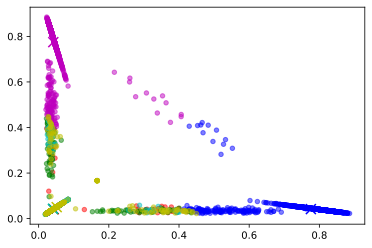

In [139]:
display_cluster(Vt.values,kmeans,6 )



In [118]:
k_vals = list(range(2,21,2))
inertia = []

for i in k_vals:
    kmeans = KMeans(n_clusters=i, random_state=4).fit(Vt.values)
    inertia.append(kmeans.inertia_)

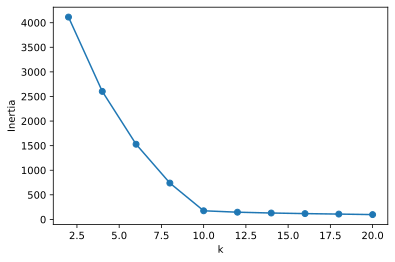

In [119]:
plt.plot(k_vals,inertia)
plt.scatter(k_vals,inertia)
plt.xlabel('k')
plt.ylabel('Inertia');